# Homework - Performance Evaluation of Diffusion models 
In this homework, you will conduct a performance comparison between two popular diffusion models: Denoising Diffusion Probabilistic Models ([DDPM](https://arxiv.org/pdf/2006.11239)) and Denoising Diffusion Implicit Models ([DDIM](https://arxiv.org/pdf/2010.02502)). Your task is to evaluate and compare the efficacy of these models in generating high-quality synthetic data, focusing on aspects such as image quality, computational efficiency, and training stability. You will implement both models, apply them to a common dataset, and analyze their performance using metrics like FID (Fréchet Inception Distance). The goal is to understand the strengths and weaknesses of DDPM and DDIM, providing insights into how their differing approaches to diffusion and denoising affect overall model performance.

## Instructions
Submit your assignment as Jupter notebook with all relevant execution outputs and plots visible. Please clearly indicate the relevant steps in your code using comments, such as data pre-processing, model definition, model training. Partial grades can be given for imcomplete results when the steps are clearly marked.

1. Ensure you have the cloned the [course repository](https://github.com/lydiaYchen/25MSGAI).
2. Open the interactive notebook version (homework_diffusion.ipynb) of homework from your local clone.
3. Complete the homework by filling the code cell and answers. Please ensure that the changes are saved.
4. Upload the notebook to the assignment in the system.

Please submit your assignment as a Jupyter Notebook, ensuring that all relevant execution outputs and plots are visible. Your notebook should include a clear and organized structure, with comments for each major step of the assignment. For example, your notebook may contain:
- Data Loading: Describe and implement the steps for preparing the dataset. This homework only works on image data with pre-trained models. Thus, we do not need to conduct customized data input, normalization, or augmentation. 
- Model Definition: Define the architectures for both the DDPM and DDIM models. Understand the details on the model parameters, layers, and any other relevant configurations.
- Performance Evaluation: Present and analyze the results of your comparison. Include plots and metrics such as FID scores and sample visualizations. Make sure these results are clearly labeled and easy to interpret.

Be sure to use comments throughout your code to clearly indicate the purpose of each section and the specific steps you are performing. While complete results are preferred, partial grades may be given if the steps are clearly marked and the work is well-documented.

## Note

Unless specified elsewhere, the tutorial follows the following hyper-paramters (The hyper-parameters for training tabular diffusion models are up to your design):


In [8]:
num_train_timesteps = 1000,
beta_start = 0.0001,
beta_end = 0.02,
beta_schedule = "linear",
clip_sample_range = 1.0,
sample_max_value = 1.0

## Exercise 1 - Impact of different dataset (4 points)

Using the template code from the lab_diffusion_1.ipynb and lab_diffusion_2.ipynb, try to discover the generating quality of images under different datasets for both DDPM and DDIM. Different datasets indicate different size of images, which also show the complexity for noising and denoising. Please specify by FID and image visualization.
Research how to compute the FID score and implement it in your notebook, use pre-trained models with the correct resolution for each datasets. 
 The datasets can be:

- mnist (1 point) : 28 * 28 sized 1-channel gray-scaled image
- cifar-10 (1 point) : 32 * 32 sized 3-channel colored image
- pokomon (1 point) : 64 * 64 sized 3-channel colored image
- butterflies (1 point) : 128 * 128 sized 3-channel colored image
- church (1 bonus point): 256 * 256 sized 3-channel colored image (if applicable)

You can find the pre-trained models [here](https://huggingface.co/models?sort=downloads). You may also choose different datasets as long as they vary in sizes. To evaluate FID, you can only choose from one dataset and with generating 10-50 images (as calculating images usually requires a lot, e.g., >10K. This tutorial is just a toy demo to run).

In [4]:
## TODO
#@title setup

import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
from diffusers import DDPMPipeline, DDIMPipeline, DDPMScheduler, DDIMScheduler, UNet2DModel
from torchmetrics.image.fid import FrechetInceptionDistance
from cleanfid import fid
from datasets import load_dataset, Dataset
from PIL import Image
import os
import tempfile

In [10]:
#@title setup of data loader, setup of models 

# function to save generated images
def save_images_to_folder(images, folder_path):
    os.makedirs(folder_path, exist_ok=True)
    for i, img in enumerate(images):
        img.save(os.path.join(folder_path, f"{i:04d}.png"))
    print(f"Saved {len(images)} images to {folder_path}")

# dataloader 
def get_dataset_and_loader(dataset_name, batch_size=1, image_size=None):
    """Load and prepare each dataset"""
    size_map = {
        'mnist': 28, 'cifar10': 32, 'pokemon': 64, 
        'butterflies': 128, 'church': 256
    }
    if image_size is None:
        image_size = size_map[dataset_name]
    
    if dataset_name == 'mnist':
        transform = transforms.Compose([
            transforms.Resize((size_map[dataset_name], size_map[dataset_name])),
            transforms.ToTensor(),
        ])
        dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)

    elif dataset_name == 'cifar10':
        transform = transforms.Compose([
            transforms.Resize((size_map[dataset_name], size_map[dataset_name])),
            transforms.ToTensor()
        ])
        dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)

    elif dataset_name == 'pokemon':
        class PokemonDataset(torch.utils.data.Dataset):
            def __init__(self, image_size=size_map[dataset_name]):
                self.hf_dataset = load_dataset("huggan/pokemon", split='train')
                self.transform = transforms.Compose([
                    transforms.Resize((image_size, image_size)),
                    transforms.ToTensor(),
                ])

            def __len__(self):
                return len(self.hf_dataset)

            def __getitem__(self, idx):
                item = self.hf_dataset[idx]
                image = item['image']
                # Convert to RGB and apply transform
                if isinstance(image, Image.Image):
                    image = image.convert('RGB')
                else:
                    image = Image.fromarray(image).convert('RGB')
                image_tensor = self.transform(image)
                return image_tensor
                
        dataset = PokemonDataset(image_size=image_size)

    elif dataset_name == 'butterflies':
        class ButterfliesDataset(torch.utils.data.Dataset):
            def __init__(self, image_size=size_map[dataset_name]):
                self.dataset = load_dataset("huggan/smithsonian_butterflies_subset", split='train')
                self.transform = transforms.Compose([
                    transforms.Resize((image_size, image_size)),
                    transforms.ToTensor(),
                ])
            
            def __len__(self):
                return len(self.dataset)
            
            def __getitem__(self, idx):
                item = self.dataset[idx]
                image = item['image']
                image = image.convert('RGB')
                image = self.transform(image)
                return image
        
        dataset = ButterfliesDataset(image_size=image_size)

    elif dataset_name == 'church':
        class ChurchDataset(torch.utils.data.Dataset):
            def __init__(self, image_size=size_map[dataset_name]):
                self.hf_dataset = load_dataset("tglcourse/lsun_church_train", split='train')
                self.transform = transforms.Compose([
                    transforms.Resize((image_size, image_size)),
                    transforms.ToTensor(),
                ])
            
            def __len__(self):
                return len(self.hf_dataset)
            
            def __getitem__(self, idx):
                item = self.hf_dataset[idx]
                image = item['image']
                if isinstance(image, Image.Image):
                    image = image.convert('RGB')
                else:
                    image = Image.fromarray(image).convert('RGB')
                return self.transform(image)
        
        dataset = ChurchDataset(image_size=image_size)

    return DataLoader(dataset, batch_size=batch_size, shuffle=True)

# setup models
def setup_models(dataset_name, device="cuda"):
    """Load DDPM and DDIM models for each dataset"""
    model_map = {
        'mnist': "1aurent/ddpm-mnist",
        'cifar10': "google/ddpm-cifar10-32",
        'pokemon': "anton-l/ddpm-ema-pokemon-64",
        'butterflies': "mrm8488/ddpm-ema-butterflies-128",
        'church': "google/ddpm-church-256"
    }
    
    model_id = model_map.get(dataset_name, model_map[dataset_name])
    
    ddpm = DDPMPipeline.from_pretrained(model_id).to(device)
    ddim = DDIMPipeline.from_pretrained(model_id).to(device)
    return ddpm, ddim

In [11]:
#@title FID calculation and evaluation

def generate_comparison_images(ddpm_pipe, ddim_pipe, dataset_name, num_images=20):
    """Generate images from both models for comparison"""
    
    # Set different steps for fair comparison
    ddpm_images = ddpm_pipe(
        batch_size=num_images,
        generator=torch.manual_seed(42)  # for reproducibility
    ).images

    ddim_images = ddim_pipe(
        batch_size=num_images,
        num_inference_steps=50,  # Fewer steps for DDIM
        generator=torch.manual_seed(42)
    ).images
    
    # Convert to tensors for FID calculation
    ddpm_tensors = torch.stack([transforms.ToTensor()(img) for img in ddpm_images])
    ddim_tensors = torch.stack([transforms.ToTensor()(img) for img in ddim_images])
    
    return ddpm_tensors, ddpm_images, ddim_tensors, ddim_images

def get_real_images_for_fid(dataloader, num_images):
    """Extract real images from dataset for FID calculation"""
    real_images = []
    for batch in dataloader:
        images = batch[0] if isinstance(batch, (list, tuple)) else batch
        real_images.append(images)
        if len(torch.cat(real_images)) >= num_images:
            break
    
    real_tensors = torch.cat(real_images)[:num_images]
    return real_tensors

# fid implementation using the package cleanfid
def calculate_fid_clean(real_tensors, gen_tensors, dataset_name):
    """Calculate FID using clean-fid"""
    
    # Create temporary directories so that you don't have to clean up later.
    with tempfile.TemporaryDirectory() as real_dir, tempfile.TemporaryDirectory() as gen_dir:
        # Save real images
        for i, img_tensor in enumerate(real_tensors):
            if img_tensor.shape[0] == 1:  # Grayscale to RGB
                img = img_tensor.repeat(3, 1, 1)
            else:
                img = img_tensor
            img_pil = transforms.ToPILImage()(img)
            img_pil.save(os.path.join(real_dir, f"real_{i:04d}.png"))
        
        # Save generated images
        for i, img_tensor in enumerate(gen_tensors):
            if img_tensor.shape[0] == 1:  # Grayscale to RGB
                img = img_tensor.repeat(3, 1, 1)
            else:
                img = img_tensor
            img_pil = transforms.ToPILImage()(img)
            img_pil.save(os.path.join(gen_dir, f"gen_{i:04d}.png"))
        
        # Calculate FID
        fid_score = fid.compute_fid(real_dir, gen_dir, device="cuda" if torch.cuda.is_available() else "cpu")
        return fid_score

import matplotlib.pyplot as plt
import os

# Visualisation
def save_simple_comparison(real_images, ddpm_images, ddim_images, ddpm_fid, ddim_fid, dataset_name, save_dir="results"):
    """Save simple comparison images to local folder"""
    os.makedirs(save_dir, exist_ok=True)
    
    # Create a simple grid comparison
    fig, axes = plt.subplots(3, 5, figsize=(10, 6))
    
    # Real images
    for i in range(5):
        if i < len(real_images):
            img = real_images[i]
            if img.shape[0] == 1:  # Grayscale to handle mnist dataset.
                axes[0, i].imshow(img.squeeze(), cmap='gray')
            else:  # Color to handle the other color datasets. 
                axes[0, i].imshow(img.permute(1, 2, 0))
            axes[0, i].set_title(f'Real {i+1}')
        axes[0, i].axis('off')
    
    # DDPM images
    for i in range(5):
        if i < len(ddpm_images):
            axes[1, i].imshow(ddpm_images[i])
            axes[1, i].set_title(f'DDPM {i+1}')
        axes[1, i].axis('off')
    
    # DDIM images
    for i in range(5):
        if i < len(ddim_images):
            axes[2, i].imshow(ddim_images[i])
            axes[2, i].set_title(f'DDIM {i+1}')
        axes[2, i].axis('off')
    
    plt.suptitle(f'{dataset_name} - DDPM FID: {ddpm_fid:.1f} | DDIM FID: {ddim_fid:.1f}')
    plt.tight_layout()
    
    # Save to file
    filename = f"{save_dir}/{dataset_name}_comparison.png"
    plt.savefig(filename, dpi=150, bbox_inches='tight')
    plt.close()
    
    print(f"Saved comparison to: {filename}")


# 
# NOTE: just place whichever dataset you want to run FID for in the datasets_to_test list.  
# 
# used 'mnist', 'cifar10', 'pokemon', 'butterflies', 'church' to test, 
# wanted to check if FID is working correctly.

# Running for 20 samples.
def evaluate_all_models():
    """Main evaluation function"""
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    results = {}
    
    datasets_to_test = ['mnist', 'cifar10', 'pokemon', 'butterflies', 'church']
    for dataset_name in datasets_to_test:
        print(f"\n Evaluating {dataset_name}...")
        
        try:
            # 1. Setup data and models
            dataloader = get_dataset_and_loader(dataset_name)
            ddpm_pipe, ddim_pipe = setup_models(dataset_name, device)
            
            
            # 2. Generate images
            ddpm_tensors, ddpm_imgs, ddim_tensors, ddim_imgs = generate_comparison_images(
                ddpm_pipe, ddim_pipe, dataset_name, num_images=20
            )
            
            # 3. Get real images for FID
            real_tensors = get_real_images_for_fid(dataloader, num_images=20)
            real_tensors = real_tensors.to(device)
            
            # 4. Calculate FID scores
            ddpm_fid = calculate_fid_clean(real_tensors, ddpm_tensors.to(device), device)
            ddim_fid = calculate_fid_clean(real_tensors, ddim_tensors.to(device), device)
            
            # 5. Store results
            results[dataset_name] = {
                'ddpm_fid': ddpm_fid,
                'ddim_fid': ddim_fid,
                'ddpm_images': ddpm_imgs,
                'ddim_images': ddim_imgs,
                'real_images': real_tensors
            }
            
            print(f"DDPM FID: {ddpm_fid:.2f}")
            print(f"DDIM FID: {ddim_fid:.2f}")

            save_simple_comparison(
                real_tensors.cpu(), 
                ddpm_imgs, 
                ddim_imgs, 
                ddpm_fid, 
                ddim_fid, 
                dataset_name
            )
            
        except Exception as e:
            print(f"Failed for {dataset_name}: {e}")
            continue
    
    return results

results = evaluate_all_models()

# Print final summary
print("\n" + "="*50)
print("FINAL RESULTS SUMMARY")
print("="*50)
for dataset, result in results.items():
    better = "DDPM" if result['ddpm_fid'] < result['ddim_fid'] else "DDIM"
    diff = abs(result['ddpm_fid'] - result['ddim_fid'])
    print(f"{dataset.upper():<12} | DDPM: {result['ddpm_fid']:6.2f} | "
          f"DDIM: {result['ddim_fid']:6.2f} | Better: {better} (by {diff:.2f})")



 Evaluating mnist...


100%|██████████| 50/50 [00:00<00:00, 123.80it/s]
/storage/homefs/kr23w045/25MSGAI/.venv/lib/python3.11/site-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 8, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpyy68iadc


FID tmpyy68iadc : 100%|██████████| 1/1 [00:01<00:00,  1.81s/it]


Found 20 images in the folder /scratch/local/32546018/tmpj72qnybt


FID tmpj72qnybt : 100%|██████████| 1/1 [00:03<00:00,  3.95s/it]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmp60bm2_m7


FID tmp60bm2_m7 : 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


Found 20 images in the folder /scratch/local/32546018/tmpfpnvutld


FID tmpfpnvutld : 100%|██████████| 1/1 [00:03<00:00,  3.11s/it]


DDPM FID: 116.52
DDIM FID: 171.32
Saved comparison to: results/mnist_comparison.png

 Evaluating cifar10...
Files already downloaded and verified


100%|██████████| 50/50 [00:00<00:00, 83.72it/s]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpz48tjwpv


FID tmpz48tjwpv : 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


Found 20 images in the folder /scratch/local/32546018/tmpsyh4zo9l


FID tmpsyh4zo9l : 100%|██████████| 1/1 [00:03<00:00,  3.08s/it]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpt27hv7jx


FID tmpt27hv7jx : 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


Found 20 images in the folder /scratch/local/32546018/tmpbnk4cyfy


FID tmpbnk4cyfy : 100%|██████████| 1/1 [00:03<00:00,  3.17s/it]


DDPM FID: 289.91
DDIM FID: 275.28
Saved comparison to: results/cifar10_comparison.png

 Evaluating pokemon...


Repo card metadata block was not found. Setting CardData to empty.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/mo

compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmp62cj04rj


FID tmp62cj04rj : 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Found 20 images in the folder /scratch/local/32546018/tmp2jzug_jk


FID tmp2jzug_jk : 100%|██████████| 1/1 [00:02<00:00,  2.97s/it]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpw9abl65u


FID tmpw9abl65u : 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


Found 20 images in the folder /scratch/local/32546018/tmpsm95lblk


FID tmpsm95lblk : 100%|██████████| 1/1 [00:03<00:00,  3.35s/it]


DDPM FID: 264.37
DDIM FID: 282.87
Saved comparison to: results/pokemon_comparison.png

 Evaluating butterflies...


Repo card metadata block was not found. Setting CardData to empty.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/hug

compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpu07s85bj


FID tmpu07s85bj : 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


Found 20 images in the folder /scratch/local/32546018/tmp2_x860ps


FID tmp2_x860ps : 100%|██████████| 1/1 [00:03<00:00,  3.31s/it]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmp85r4ki1v


FID tmp85r4ki1v : 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Found 20 images in the folder /scratch/local/32546018/tmpaaxxq12_


FID tmpaaxxq12_ : 100%|██████████| 1/1 [00:03<00:00,  3.16s/it]


DDPM FID: 164.67
DDIM FID: 312.60
Saved comparison to: results/butterflies_comparison.png

 Evaluating church...


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04.
Defaulting to u

compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmpl2idxfbe


FID tmpl2idxfbe : 100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


Found 20 images in the folder /scratch/local/32546018/tmpvlpsk19k


FID tmpvlpsk19k : 100%|██████████| 1/1 [00:03<00:00,  3.29s/it]


compute FID between two folders
Found 20 images in the folder /scratch/local/32546018/tmprsn5rler


FID tmprsn5rler : 100%|██████████| 1/1 [00:01<00:00,  1.61s/it]


Found 20 images in the folder /scratch/local/32546018/tmpn41mzjjk


FID tmpn41mzjjk : 100%|██████████| 1/1 [00:03<00:00,  3.64s/it]


DDPM FID: 156.57
DDIM FID: 162.68
Saved comparison to: results/church_comparison.png

FINAL RESULTS SUMMARY
MNIST        | DDPM: 116.52 | DDIM: 171.32 | Better: DDPM (by 54.80)
CIFAR10      | DDPM: 289.91 | DDIM: 275.28 | Better: DDIM (by 14.63)
POKEMON      | DDPM: 264.37 | DDIM: 282.87 | Better: DDPM (by 18.50)
BUTTERFLIES  | DDPM: 164.67 | DDIM: 312.60 | Better: DDPM (by 147.93)
CHURCH       | DDPM: 156.57 | DDIM: 162.68 | Better: DDPM (by 6.11)


# Insights for exercise - 1
- DDPM is the More Reliable performer - DDPM wins on 4 out of 5 datasets.
- DDIM's single win is on CIFAR-10, suggesting its deterministic sampling is more effective for noisy and diverse data - complex and real world images. Maybe tuning of parameters of eta and tweaking of inference steps may improve performance.
- DDPM dominates on stylistically consistent datasets (Pokemon, Butterflies, Church, MNIST). Its stochastic nature acts as a better regularizer.
- The results sho core compromise- choose DDIM for speed and peak performance on complex data, but choose DDPM for reliability and consistency across diff. tasks.

# Visualisation of Exercise - 1

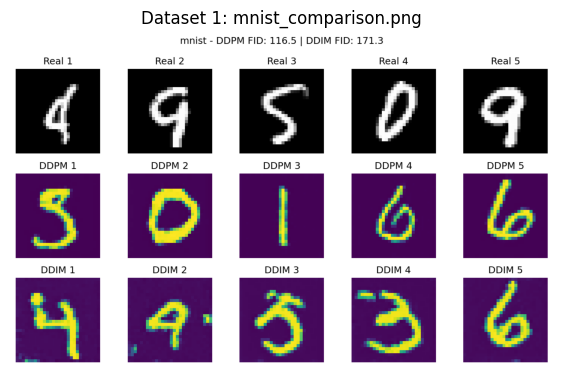

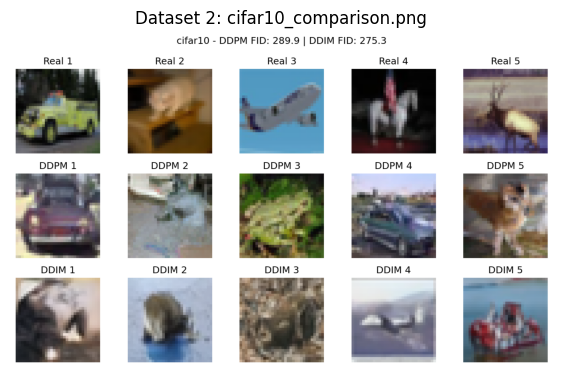

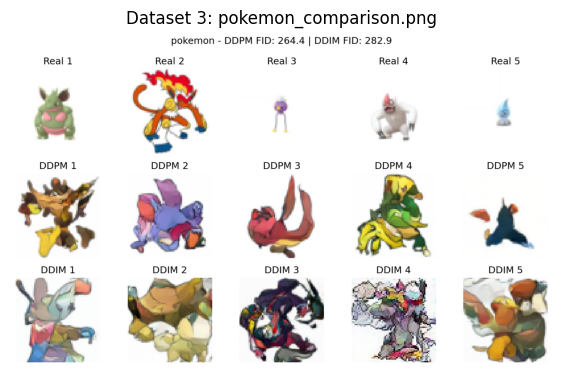

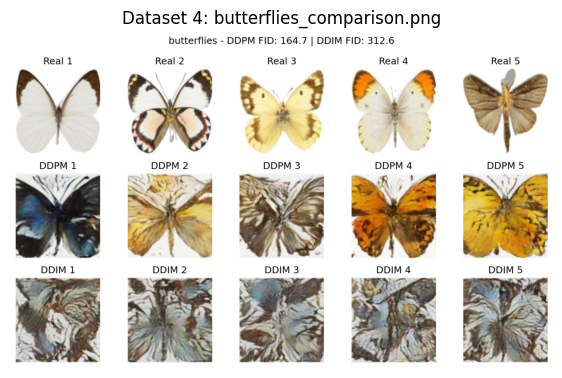

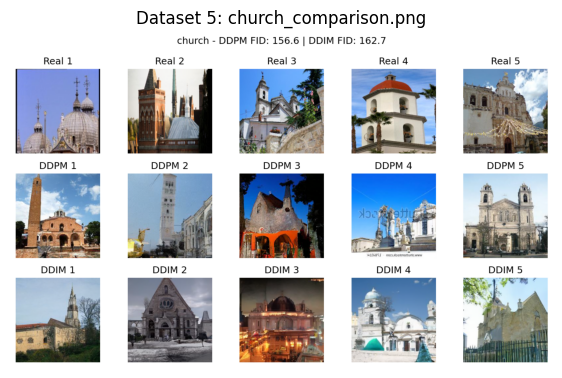

In [13]:

image_paths = [
    os.path.join("results", "mnist_comparison.png"),
    os.path.join("results", "cifar10_comparison.png"),
    os.path.join("results", "pokemon_comparison.png"),
    os.path.join("results", "butterflies_comparison.png"),
    os.path.join("results", "church_comparison.png"),
]

for i, path in enumerate(image_paths):
    try:
        img = Image.open(path)
        plt.figure(figsize=(7, 7)) 
        plt.imshow(img)
        plt.title(f'Dataset {i+1}: {os.path.basename(path)}')
        plt.axis('off')
        plt.show()

    except FileNotFoundError:
        print(f"Error: Image file not found at {path}")
    except Exception as e:
        print(f"An unexpected error occurred for {path}: {e}")

## Exercise 2 - Output intermediate sampling results (4 points)

Comparing the inference results of DDPM (2 points) and DDIM (2 points) by generating and analyzing their intermediate sampling results. Specifically, you need to run each model through a series of diffusion steps starting from a noisy image, capturing and outputting images at specified intervals to observe how each model refines the image over time. This involves setting up both models, performing inference at regular intervals, and saving these intermediate images to visualize and compare the evolution of image quality between the two models. This task requires to capture and analyze the differences in the sampling processes of DDPM and DDIM, providing insights into their respective performance in transitioning from noise to clearer images. You may also choose different datasets as long as they vary in sizes.

Comparing DDPM vs DDIM sampling processes

DATASETS AND MODELS:
   • MNIST       : 1aurent/ddpm-mnist (28x28 grayscale)
   • CIFAR10     : google/ddpm-cifar10-32 (32x32 color)
   • CHURCH      : google/ddpm-church-256 (256x256 color)
   • POKEMON     : anton-l/ddpm-ema-pokemon-64 (64x64 color)
   • BUTTERFLIES : mrm8488/ddpm-ema-butterflies-128 (128x128 color)

ANALYZING: MNIST
Model: 1aurent/ddpm-mnist (28x28 grayscale)
Using device: cuda

INTERMEDIATE SAMPLING ANALYSIS - MNIST


Loading pipeline components...: 100%|██████████| 2/2 [00:00<00:00, 95.53it/s]

Configuration:
   • Dataset: mnist
   • Image size: 28x28
   • Channels: 1

1.DDPM SAMPLING PROGRESSION:
DDPM Denoising - Capturing steps: [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


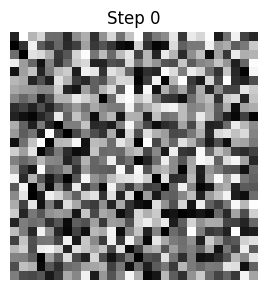

/scratch/local/32546018/ipykernel_3024723/1712156674.py:68: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  return Image.fromarray(image_processed[0]) if not is_grayscale else Image.fromarray(image_processed[0].squeeze(), mode='L')


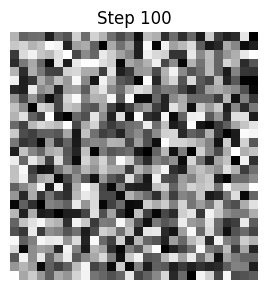

Step 100/1000 - Captured and displayed


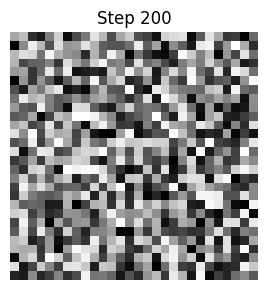

Step 200/1000 - Captured and displayed


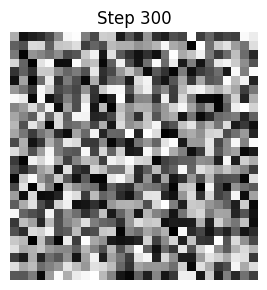

Step 300/1000 - Captured and displayed


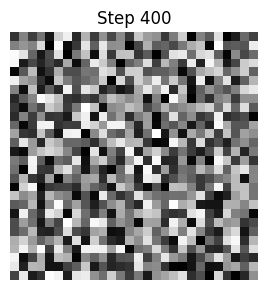

Step 400/1000 - Captured and displayed


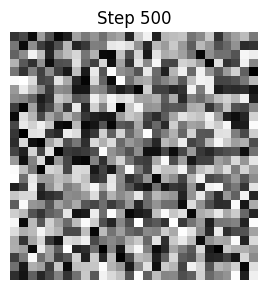

Step 500/1000 - Captured and displayed


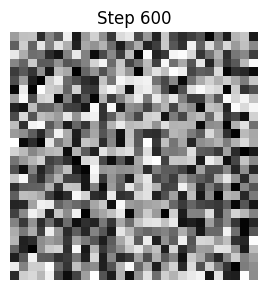

Step 600/1000 - Captured and displayed


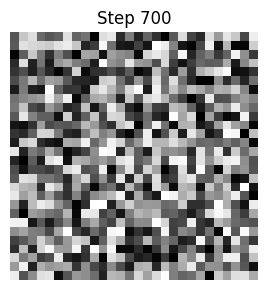

Step 700/1000 - Captured and displayed


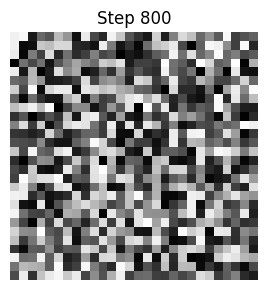

Step 800/1000 - Captured and displayed


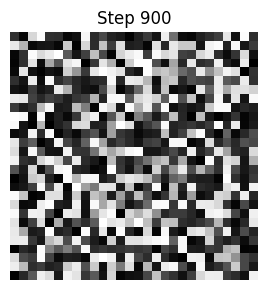

Step 900/1000 - Captured and displayed


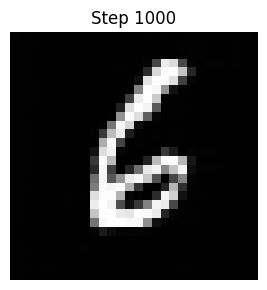

Step 1000/1000 - Captured and displayed

2.DDIM SAMPLING PROGRESSION:
DDIM Denoising - Capturing steps: [0, 10, 20, 30, 40, 50]


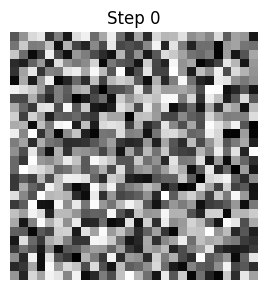

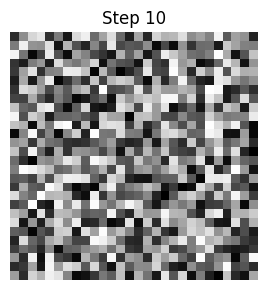

Step 10/50 - Captured and displayed


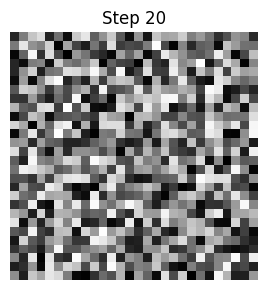

Step 20/50 - Captured and displayed


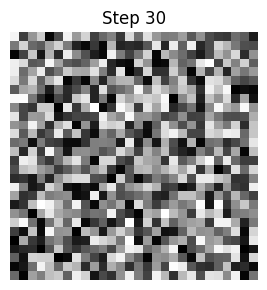

Step 30/50 - Captured and displayed


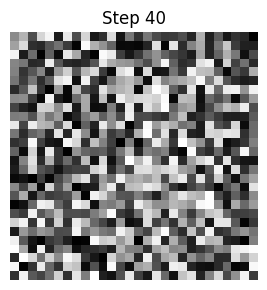

Step 40/50 - Captured and displayed


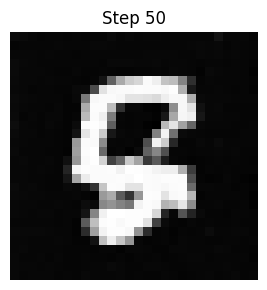

Step 50/50 - Captured and displayed

3.CREATING AND DISPLAYING GIFS:
DDPM Progression GIF:
GIF saved: sampling_results/mnist_ddpm_progression.gif


DDIM Progression GIF:
GIF saved: sampling_results/mnist_ddim_progression.gif



4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):

SIDE-BY-SIDE COMPARISON: MNIST


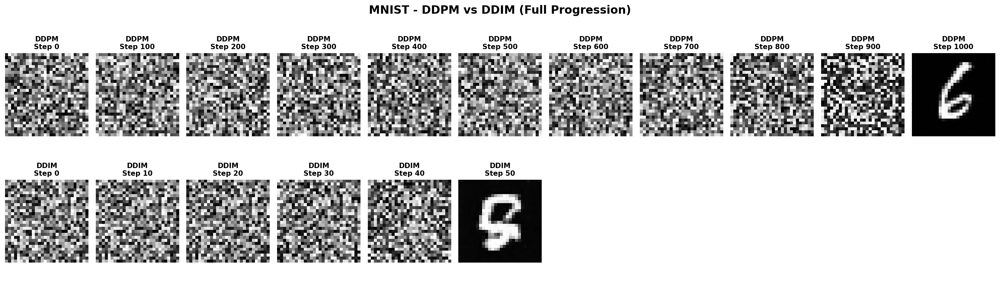

Successfully completed mnist analysis

ANALYZING: CIFAR10
Model: google/ddpm-cifar10-32 (32x32 color)
Using device: cuda

INTERMEDIATE SAMPLING ANALYSIS - CIFAR10


Loading pipeline components...: 100%|██████████| 2/2 [00:00<00:00, 81.09it/s]

Configuration:
   • Dataset: cifar10
   • Image size: 32x32
   • Channels: 3

1.DDPM SAMPLING PROGRESSION:
DDPM Denoising - Capturing steps: [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


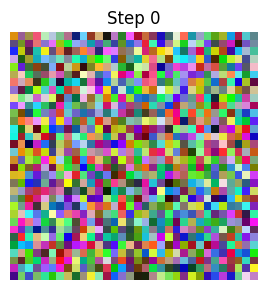

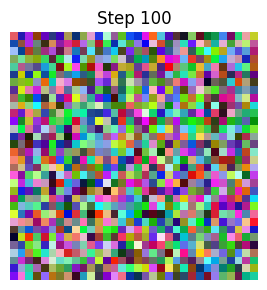

Step 100/1000 - Captured and displayed


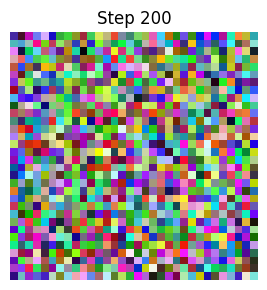

Step 200/1000 - Captured and displayed


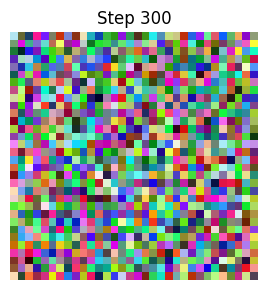

Step 300/1000 - Captured and displayed


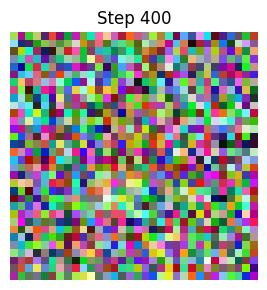

Step 400/1000 - Captured and displayed


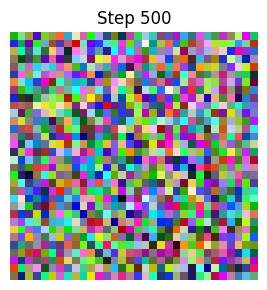

Step 500/1000 - Captured and displayed


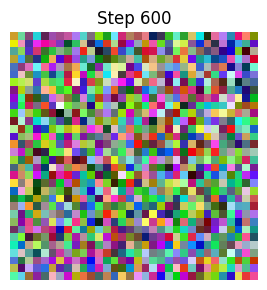

Step 600/1000 - Captured and displayed


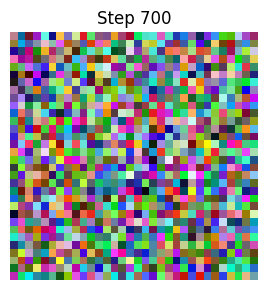

Step 700/1000 - Captured and displayed


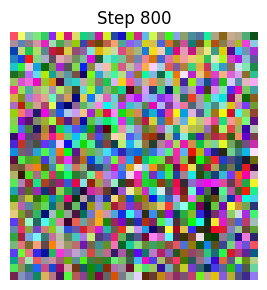

Step 800/1000 - Captured and displayed


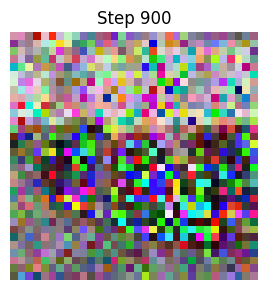

Step 900/1000 - Captured and displayed


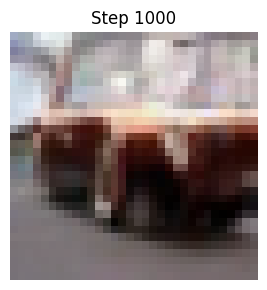

Step 1000/1000 - Captured and displayed

2.DDIM SAMPLING PROGRESSION:
DDIM Denoising - Capturing steps: [0, 10, 20, 30, 40, 50]


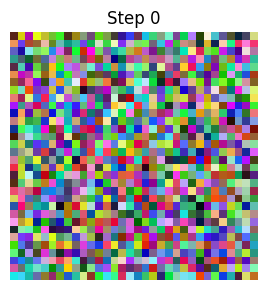

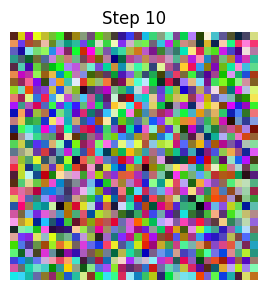

Step 10/50 - Captured and displayed


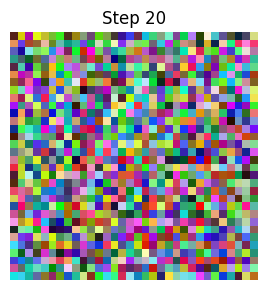

Step 20/50 - Captured and displayed


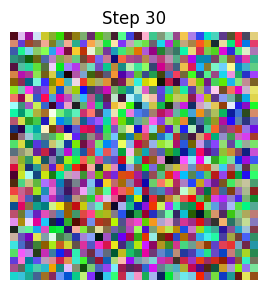

Step 30/50 - Captured and displayed


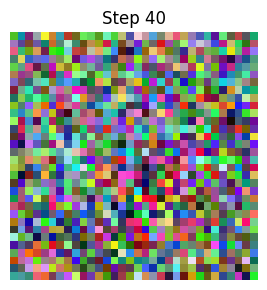

Step 40/50 - Captured and displayed


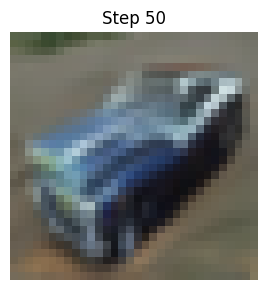

Step 50/50 - Captured and displayed

3.CREATING AND DISPLAYING GIFS:
DDPM Progression GIF:
GIF saved: sampling_results/cifar10_ddpm_progression.gif


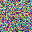

DDIM Progression GIF:
GIF saved: sampling_results/cifar10_ddim_progression.gif


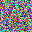


4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):

SIDE-BY-SIDE COMPARISON: CIFAR10


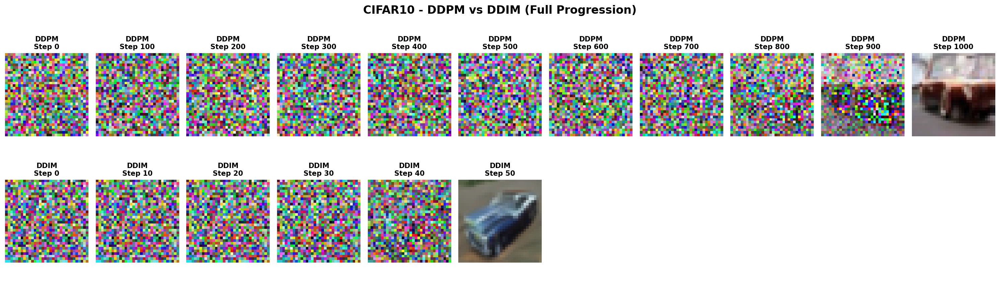

Successfully completed cifar10 analysis

ANALYZING: POKEMON
Model: anton-l/ddpm-ema-pokemon-64 (64x64 color)
Using device: cuda

INTERMEDIATE SAMPLING ANALYSIS - POKEMON


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f189fa098429bcdf45423/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--anton-l--ddpm-ema-pokemon-64/snapshots/201b396f6a70a66cf22f18

Configuration:
   • Dataset: pokemon
   • Image size: 64x64
   • Channels: 3

1.DDPM SAMPLING PROGRESSION:
DDPM Denoising - Capturing steps: [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


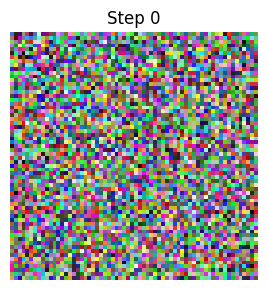

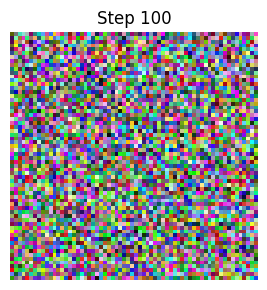

Step 100/1000 - Captured and displayed


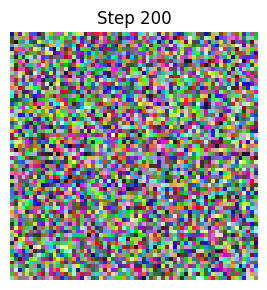

Step 200/1000 - Captured and displayed


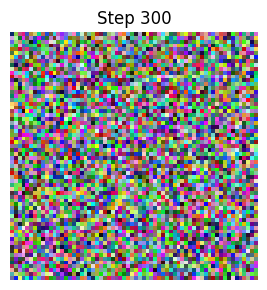

Step 300/1000 - Captured and displayed


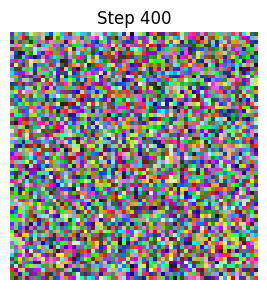

Step 400/1000 - Captured and displayed


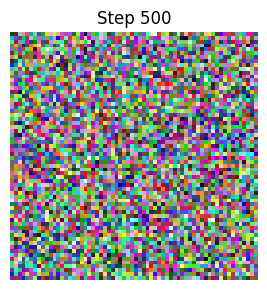

Step 500/1000 - Captured and displayed


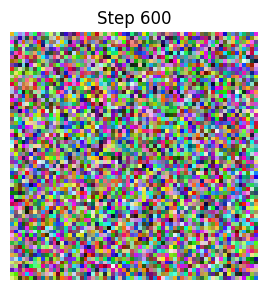

Step 600/1000 - Captured and displayed


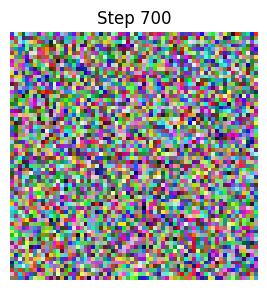

Step 700/1000 - Captured and displayed


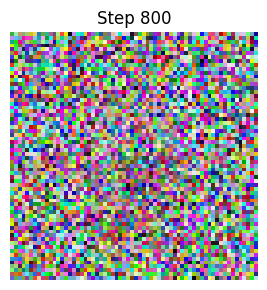

Step 800/1000 - Captured and displayed


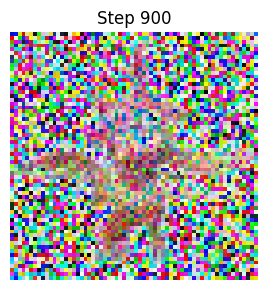

Step 900/1000 - Captured and displayed


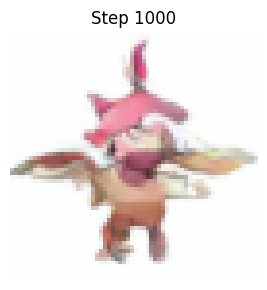

Step 1000/1000 - Captured and displayed

2.DDIM SAMPLING PROGRESSION:
DDIM Denoising - Capturing steps: [0, 10, 20, 30, 40, 50]


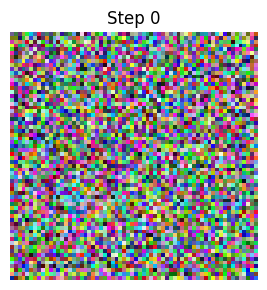

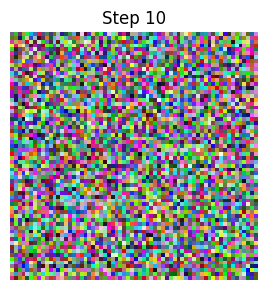

Step 10/50 - Captured and displayed


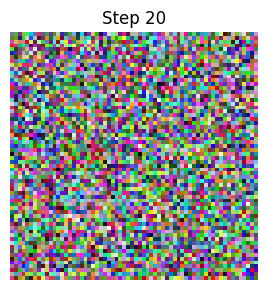

Step 20/50 - Captured and displayed


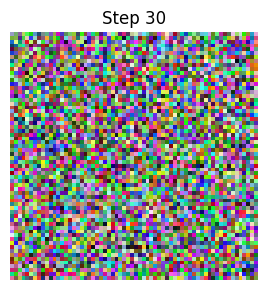

Step 30/50 - Captured and displayed


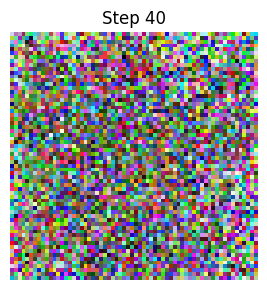

Step 40/50 - Captured and displayed


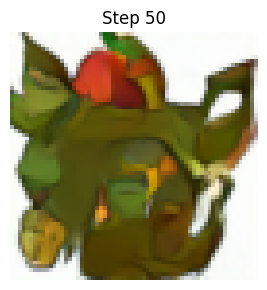

Step 50/50 - Captured and displayed

3.CREATING AND DISPLAYING GIFS:
DDPM Progression GIF:
GIF saved: sampling_results/pokemon_ddpm_progression.gif


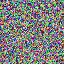

DDIM Progression GIF:
GIF saved: sampling_results/pokemon_ddim_progression.gif


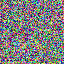


4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):

SIDE-BY-SIDE COMPARISON: POKEMON


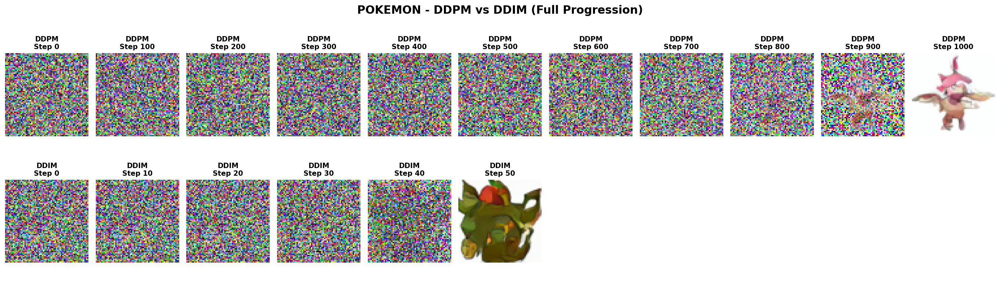

Successfully completed pokemon analysis

ANALYZING: BUTTERFLIES
Model: mrm8488/ddpm-ema-butterflies-128 (128x128 color)
Using device: cuda

INTERMEDIATE SAMPLING ANALYSIS - BUTTERFLIES


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a89dfb640672f10d637df7c0e869267d5ddd4fe/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--mrm8488--ddpm-ema-butterflies-128/snapshots/6a

Configuration:
   • Dataset: butterflies
   • Image size: 128x128
   • Channels: 3

1.DDPM SAMPLING PROGRESSION:
DDPM Denoising - Capturing steps: [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


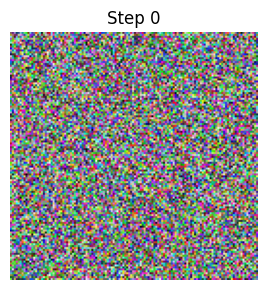

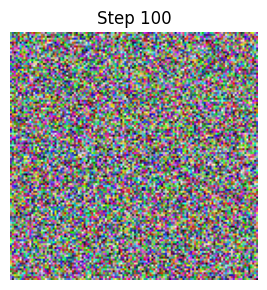

Step 100/1000 - Captured and displayed


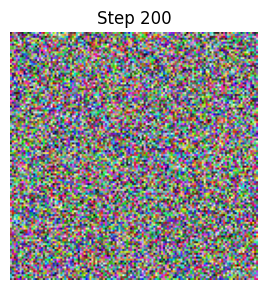

Step 200/1000 - Captured and displayed


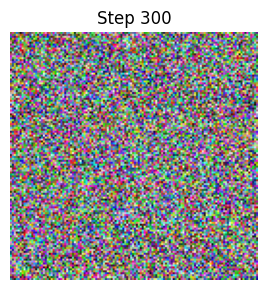

Step 300/1000 - Captured and displayed


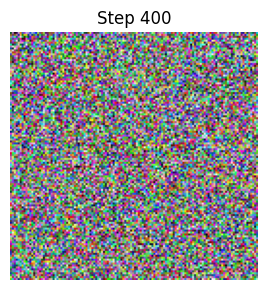

Step 400/1000 - Captured and displayed


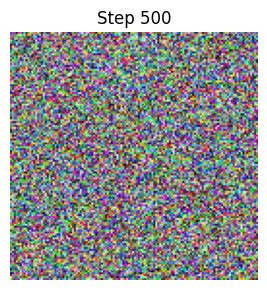

Step 500/1000 - Captured and displayed


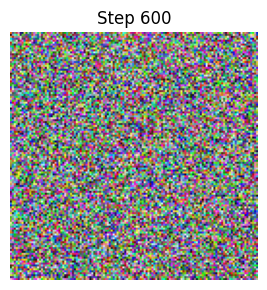

Step 600/1000 - Captured and displayed


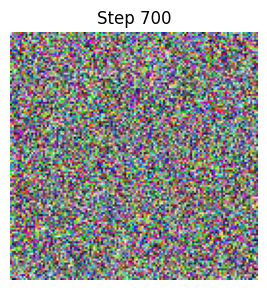

Step 700/1000 - Captured and displayed


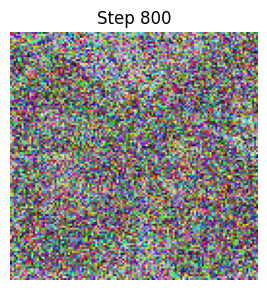

Step 800/1000 - Captured and displayed


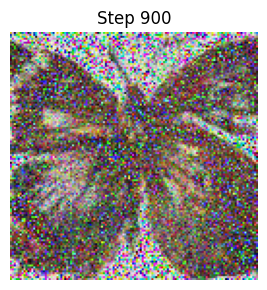

Step 900/1000 - Captured and displayed


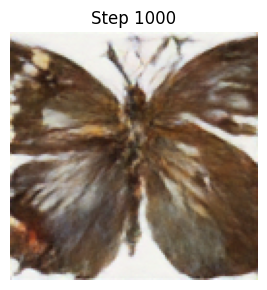

Step 1000/1000 - Captured and displayed

2.DDIM SAMPLING PROGRESSION:
DDIM Denoising - Capturing steps: [0, 10, 20, 30, 40, 50]


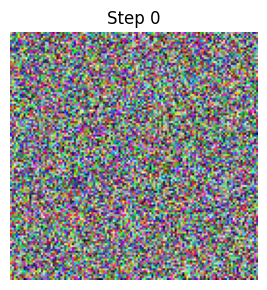

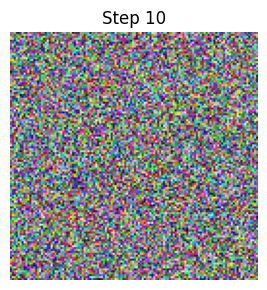

Step 10/50 - Captured and displayed


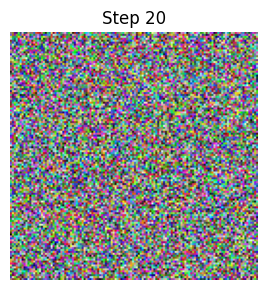

Step 20/50 - Captured and displayed


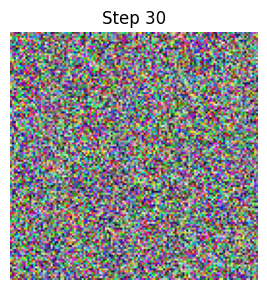

Step 30/50 - Captured and displayed


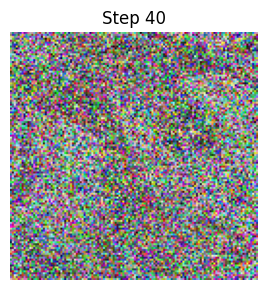

Step 40/50 - Captured and displayed


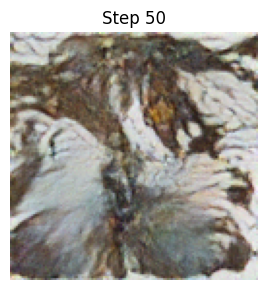

Step 50/50 - Captured and displayed

3.CREATING AND DISPLAYING GIFS:
DDPM Progression GIF:
GIF saved: sampling_results/butterflies_ddpm_progression.gif


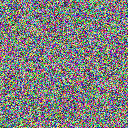

DDIM Progression GIF:
GIF saved: sampling_results/butterflies_ddim_progression.gif


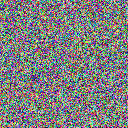


4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):

SIDE-BY-SIDE COMPARISON: BUTTERFLIES


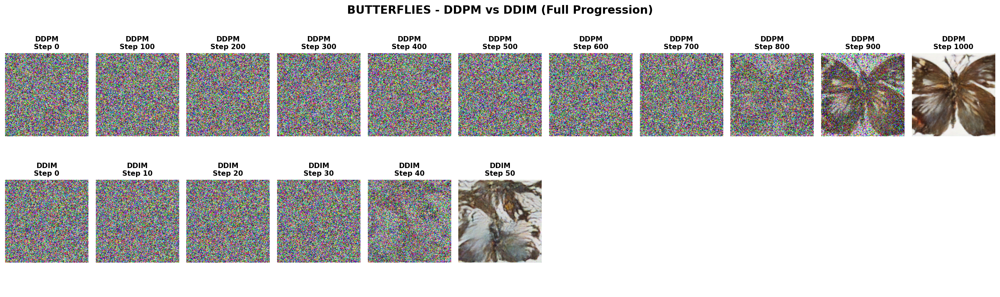

Successfully completed butterflies analysis

ANALYZING: CHURCH
Model: google/ddpm-church-256 (256x256 color)
Using device: cuda

INTERMEDIATE SAMPLING ANALYSIS - CHURCH


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]An error occurred while trying to fetch /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04: Error no file named diffusion_pytorch_model.safetensors found in directory /storage/homefs/kr23w045/.cache/huggingface/hub/models--google--ddpm-church-256/snapshots/5a1118b5a35e744d59a4215a8c72a4d7619b9e04.
Defaulting to u

Configuration:
   • Dataset: church
   • Image size: 256x256
   • Channels: 3

1.DDPM SAMPLING PROGRESSION:
DDPM Denoising - Capturing steps: [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


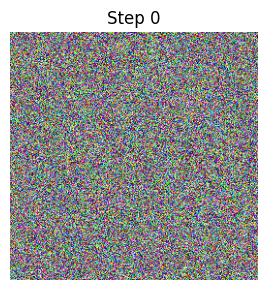

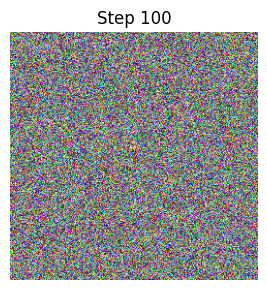

Step 100/1000 - Captured and displayed


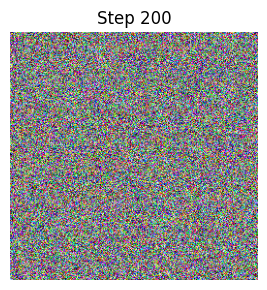

Step 200/1000 - Captured and displayed


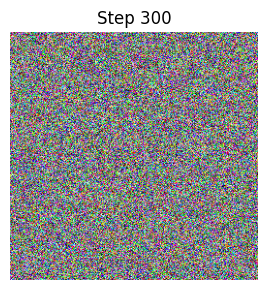

Step 300/1000 - Captured and displayed


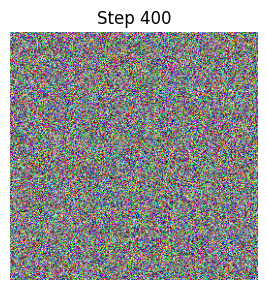

Step 400/1000 - Captured and displayed


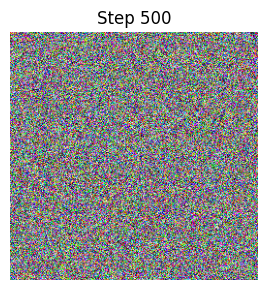

Step 500/1000 - Captured and displayed


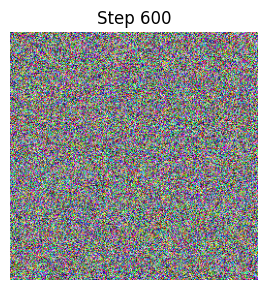

Step 600/1000 - Captured and displayed


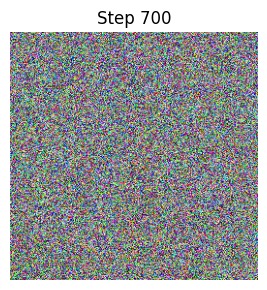

Step 700/1000 - Captured and displayed


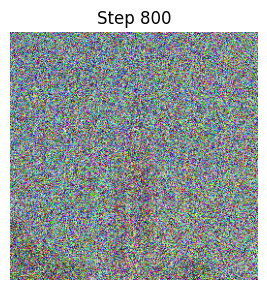

Step 800/1000 - Captured and displayed


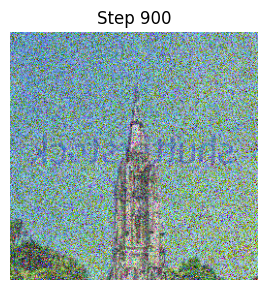

Step 900/1000 - Captured and displayed


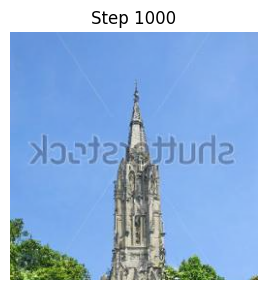

Step 1000/1000 - Captured and displayed

2.DDIM SAMPLING PROGRESSION:
DDIM Denoising - Capturing steps: [0, 10, 20, 30, 40, 50]


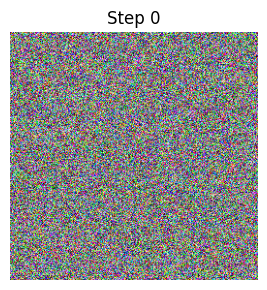

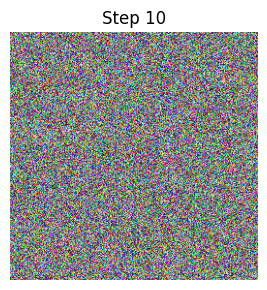

Step 10/50 - Captured and displayed


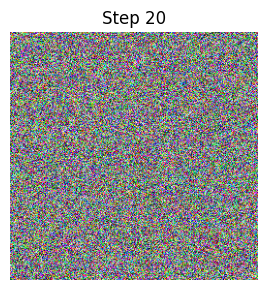

Step 20/50 - Captured and displayed


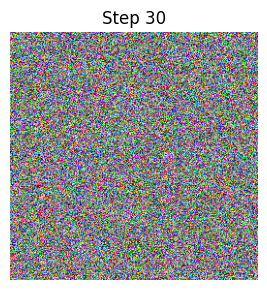

Step 30/50 - Captured and displayed


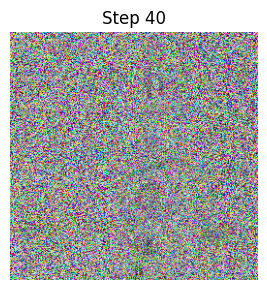

Step 40/50 - Captured and displayed


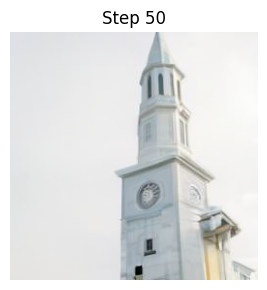

Step 50/50 - Captured and displayed

3.CREATING AND DISPLAYING GIFS:
DDPM Progression GIF:
GIF saved: sampling_results/church_ddpm_progression.gif


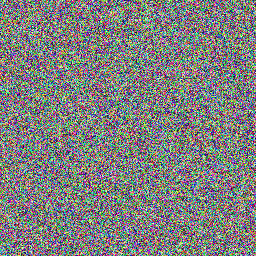

DDIM Progression GIF:
GIF saved: sampling_results/church_ddim_progression.gif


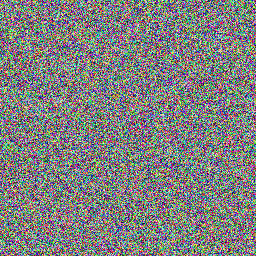


4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):

SIDE-BY-SIDE COMPARISON: CHURCH


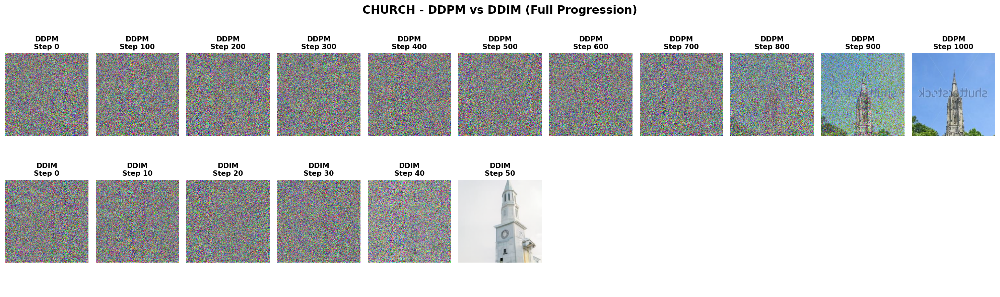

Successfully completed church analysis


In [14]:
#@title Exercise 2 - output intermediate sampling results for DDPM and DDIM
    # ddpm_capture_steps = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]
    # ddim_capture_steps = [0, 10, 20, 30, 40, 50]

from IPython.display import display, clear_output
import io

def setup_models_and_schedulers(dataset_name, device="cuda"):
    """Load DDPM and DDIM models for each dataset"""
    model_map = {
        'mnist': "1aurent/ddpm-mnist",
        'cifar10': "google/ddpm-cifar10-32",
        'pokemon': "anton-l/ddpm-ema-pokemon-64",
        'butterflies': "mrm8488/ddpm-ema-butterflies-128",
        'church': "google/ddpm-church-256"
    }
    
    model_id = model_map.get(dataset_name, model_map[dataset_name])
    
    try:
        # Load pipelines to get the UNet
        ddpm_pipe = DDPMPipeline.from_pretrained(model_id)
        ddim_pipe = DDIMPipeline.from_pretrained(model_id)
        
        # Get UNet and move to device
        unet = ddpm_pipe.unet.to(device)
        ddpm_scheduler = DDPMScheduler.from_config(ddpm_pipe.scheduler.config)
        ddim_scheduler = DDIMScheduler.from_config(ddpm_pipe.scheduler.config)
        
        return unet, ddpm_scheduler, ddim_scheduler

    # Note: had to introduce this exception handling because the scheduler.json file is missing for 2 models.  
    except Exception as e:
        try:
            ddpm_pipe = DDPMPipeline.from_pretrained(model_id)
            unet = ddpm_pipe.unet.to(device)
            
            ddpm_scheduler = ddpm_pipe.scheduler
            ddim_scheduler = DDIMScheduler.from_config(ddpm_pipe.scheduler.config)
            return unet, ddpm_scheduler, ddim_scheduler
        except Exception as e2:
            print(f"Error loading model: {e2}")
            raise e2

def display_sample_inline(sample, step, is_grayscale=False):
    """Display sample image inline in Jupyter notebook"""
    image_processed = sample.cpu().permute(0, 2, 3, 1)
    image_processed = (image_processed + 1.0) * 127.5
    image_processed = image_processed.numpy().astype(np.uint8)
    
    fig, ax = plt.subplots(1, 1, figsize=(3, 3))
    if is_grayscale:
        ax.imshow(image_processed[0].squeeze(), cmap='gray')
    else:
        ax.imshow(image_processed[0])
    ax.set_title(f'Step {step}')
    ax.axis('off')
    plt.tight_layout()
    
    # Display inline
    buf = io.BytesIO()
    plt.savefig(buf, format='png', dpi=100, bbox_inches='tight')
    buf.seek(0)
    img = Image.open(buf)
    display(img)
    plt.close()
    
    return Image.fromarray(image_processed[0]) if not is_grayscale else Image.fromarray(image_processed[0].squeeze(), mode='L')

def create_and_display_gif(images, filename, duration=500):
    """Create GIF from list of PIL images and display it inline"""
    if images:
        # Save GIF to file
        images[0].save(
            filename,
            save_all=True,
            append_images=images[1:],
            duration=duration,
            loop=0
        )
        print(f"GIF saved: {filename}")
        
        # Display GIF inline
        display(Image.open(filename))

def run_ddpm_sampling_with_display(unet, scheduler, device, capture_steps=None, is_grayscale=False):
    """Run DDPM sampling and display progress inline"""
    if capture_steps is None:
        capture_steps = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]
    
    print(f"DDPM Denoising - Capturing steps: {capture_steps}")
    
    # Initialize with random noise
    sample = torch.randn(
        1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size
    ).to(device)
    
    scheduler.set_timesteps(1000)
    scheduler.timesteps = scheduler.timesteps.to(device)
    
    captured_images = []
    all_images_for_gif = []
    
    # Capture initial noise (step 0)
    if 0 in capture_steps:
        image_pil = display_sample_inline(sample, 0, is_grayscale)
        captured_images.append((0, image_pil))
        all_images_for_gif.append(image_pil)
    
    for i, t in enumerate(scheduler.timesteps):
        with torch.no_grad():
            residual = unet(sample, t).sample

        # Compute less noisy image
        sample = scheduler.step(residual, t, sample).prev_sample

        current_step = i + 1
        
        # Capture at specified steps
        if current_step in capture_steps:
            image_pil = display_sample_inline(sample, current_step, is_grayscale)
            captured_images.append((current_step, image_pil))
            all_images_for_gif.append(image_pil)
            print(f"Step {current_step}/1000 - Captured and displayed")
    
    return captured_images, all_images_for_gif

def run_ddim_sampling_with_display(unet, scheduler, device, capture_steps=None, is_grayscale=False):
    """Run DDIM sampling and display progress inline"""
    if capture_steps is None:
        capture_steps = [0, 10, 20, 30, 40, 50]
    
    print(f"DDIM Denoising - Capturing steps: {capture_steps}")
    
    # Initialize with random noise
    sample = torch.randn(
        1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size
    ).to(device)
    
    scheduler.set_timesteps(50)
    scheduler.timesteps = scheduler.timesteps.to(device)
    
    captured_images = []
    all_images_for_gif = []
    
    # Capture initial noise (step 0)
    if 0 in capture_steps:
        image_pil = display_sample_inline(sample, 0, is_grayscale)
        captured_images.append((0, image_pil))
        all_images_for_gif.append(image_pil)
    
    for i, t in enumerate(scheduler.timesteps):
        with torch.no_grad():
            residual = unet(sample, t).sample

        # Compute less noisy image
        sample = scheduler.step(residual, t, sample).prev_sample

        current_step = i + 1
        
        # Capture at specified steps
        if current_step in capture_steps:
            image_pil = display_sample_inline(sample, current_step, is_grayscale)
            captured_images.append((current_step, image_pil))
            all_images_for_gif.append(image_pil)
            print(f"Step {current_step}/50 - Captured and displayed")
    
    return captured_images, all_images_for_gif

def visualize_side_by_side_inline(ddpm_images, ddim_images, dataset_name):
    """Display DDPM vs DDIM comparison inline"""
    print(f"\nSIDE-BY-SIDE COMPARISON: {dataset_name.upper()}")
    
    # Use ALL DDPM steps 
    ddpm_steps_to_show = ddpm_images
    
    # For DDIM, show all steps
    ddim_steps_to_show = ddim_images
    
    # Create a grid that shows all DDPM steps in one row and DDIM in another
    num_ddpm_steps = len(ddpm_steps_to_show)
    num_ddim_steps = len(ddim_steps_to_show)
    
    # Create figure with 2 rows: one for DDPM, one for DDIM
    fig, axes = plt.subplots(2, max(num_ddpm_steps, num_ddim_steps), figsize=(20, 6))
    
    # DDPM row - show ALL steps (0-1000)
    for i in range(num_ddpm_steps):
        ddpm_step, ddpm_img = ddpm_steps_to_show[i]
        if dataset_name == 'mnist':
            axes[0, i].imshow(np.array(ddpm_img), cmap='gray')
        else:
            axes[0, i].imshow(np.array(ddpm_img))
        axes[0, i].set_title(f'DDPM\nStep {ddpm_step}', fontweight='bold', fontsize=10)
        axes[0, i].axis('off')
    
    # Hide unused subplots in DDPM row
    for i in range(num_ddpm_steps, axes.shape[1]):
        axes[0, i].axis('off')
    
    # DDIM row - show all steps
    for i in range(num_ddim_steps):
        ddim_step, ddim_img = ddim_steps_to_show[i]
        if dataset_name == 'mnist':
            axes[1, i].imshow(np.array(ddim_img), cmap='gray')
        else:
            axes[1, i].imshow(np.array(ddim_img))
        axes[1, i].set_title(f'DDIM\nStep {ddim_step}', fontweight='bold', fontsize=10)
        axes[1, i].axis('off')
    
    # Hide unused subplots in DDIM row
    for i in range(num_ddim_steps, axes.shape[1]):
        axes[1, i].axis('off')
    
    axes[0, 0].set_ylabel('DDPM\n(1000 steps)', rotation=90, size='large', fontweight='bold')
    axes[1, 0].set_ylabel('DDIM\n(50 steps)', rotation=90, size='large', fontweight='bold')
    
    plt.suptitle(f'{dataset_name.upper()} - DDPM vs DDIM (Full Progression)', fontsize=16, fontweight='bold')
    plt.tight_layout()
    
    # Display inline
    buf = io.BytesIO()
    plt.savefig(buf, format='png', dpi=150, bbox_inches='tight')
    buf.seek(0)
    img = Image.open(buf)
    display(img)
    plt.close()

def run_intermediate_sampling_analysis(dataset_name="mnist"):
    """Main function to run intermediate sampling analysis with inline display"""
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    print(f"\nINTERMEDIATE SAMPLING ANALYSIS - {dataset_name.upper()}")
    print("=" * 60)
    
    try:
        # Setup models and schedulers
        unet, ddpm_scheduler, ddim_scheduler = setup_models_and_schedulers(dataset_name, device)
        
        print("Configuration:")
        print(f"   • Dataset: {dataset_name}")
        print(f"   • Image size: {unet.config.sample_size}x{unet.config.sample_size}")
        print(f"   • Channels: {unet.config.in_channels}")
        
        # Check if grayscale (MNIST)
        is_grayscale = (dataset_name == 'mnist')
        
        # Define capture steps - ALL steps from 0 to 1000 for DDPM
        ddpm_capture_steps = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]
        ddim_capture_steps = [0, 10, 20, 30, 40, 50]
        
        # Run DDPM sampling with inline display
        print(f"\n1.DDPM SAMPLING PROGRESSION:")
        ddpm_images, ddpm_gif_images = run_ddpm_sampling_with_display(
            unet, ddpm_scheduler, device, 
            capture_steps=ddpm_capture_steps, 
            is_grayscale=is_grayscale
        )
        
        # Run DDIM sampling with inline display
        print(f"\n2.DDIM SAMPLING PROGRESSION:")
        ddim_images, ddim_gif_images = run_ddim_sampling_with_display(
            unet, ddim_scheduler, device,
            capture_steps=ddim_capture_steps,
            is_grayscale=is_grayscale
        )
        
        # Create and display GIFs inline
        print(f"\n3.CREATING AND DISPLAYING GIFS:")
        os.makedirs("sampling_results", exist_ok=True)
        
        # DDPM GIF
        if ddpm_gif_images:
            print("DDPM Progression GIF:")
            create_and_display_gif(ddpm_gif_images, f"sampling_results/{dataset_name}_ddpm_progression.gif", duration=300)
        
        # DDIM GIF
        if ddim_gif_images:
            print("DDIM Progression GIF:")
            create_and_display_gif(ddim_gif_images, f"sampling_results/{dataset_name}_ddim_progression.gif", duration=300)
        
        # Side-by-side comparison with ALL DDPM steps
        print(f"\n4.SIDE-BY-SIDE COMPARISON (Full DDPM Progression):")
        visualize_side_by_side_inline(ddpm_images, ddim_images, dataset_name)
        
        return ddpm_images, ddim_images
        
    except Exception as e:
        print(f"Error: {e}")
        import traceback
        traceback.print_exc()
        return [], []

def run_complete_exercise_2():
    """Run for all datasets with custom models"""
    print("Comparing DDPM vs DDIM sampling processes")
    print("=" * 60)
    
    # All datasets with their custom models
    datasets_to_test = ['mnist', 'cifar10', 'pokemon', 'butterflies', 'church']
    
    # Model info
    model_info = {
        'mnist': "1aurent/ddpm-mnist (28x28 grayscale)",
        'cifar10': "google/ddpm-cifar10-32 (32x32 color)", 
        'church': "google/ddpm-church-256 (256x256 color)",
        'pokemon': "anton-l/ddpm-ema-pokemon-64 (64x64 color)",
        'butterflies': "mrm8488/ddpm-ema-butterflies-128 (128x128 color)",
    }
    
    print("\nDATASETS AND MODELS:")
    for dataset, info in model_info.items():
        print(f"   • {dataset.upper():<12}: {info}")
    
    all_results = {}
    
    for dataset in datasets_to_test:
        print(f"\n" + "="*60)
        print(f"ANALYZING: {dataset.upper()}")
        print(f"Model: {model_info[dataset]}")
        print("="*60)
        
        try:
            ddpm_results, ddim_results = run_intermediate_sampling_analysis(dataset)
            
            if ddpm_results and ddim_results:
                all_results[dataset] = {
                    'ddpm': ddpm_results,
                    'ddim': ddim_results
                }
                print(f"Successfully completed {dataset} analysis")
            else:
                print(f"Failed to analyze {dataset}")
                
        except Exception as e:
            print(f"Critical error for {dataset}: {e}")
            continue
        
    return all_results

# Run the complete exercise
results = run_complete_exercise_2()

# Some Insights for Exercise 2
- DDPM's process provides a gradual, exploratory denoising path, which is more robust for homogeneous datasets (like Butterflies) as it avoids premature convergence.
- DDIM creates a more direct and faster path from noise to image making it efficient for complex, varied datasets like cifar10.
- The visual progression shows DDIM forms recognizable structure much earlier, but this speed can cause irreversible errors on niche data. like in the butterfly dataset. 
- whereas DDPM's slower, noisier progression allows for more "course corrections," leading to higher fidelity for specific styles and textures.

# GIF visualisation for the datasets for DDPM and DDIM processes 

In [25]:
# @title Display MNIST GIFs
from IPython.display import display, Image

print("MNIST GIF")

ddpm_path = "sampling_results/mnist_ddpm_progression.gif"
ddim_path = "sampling_results/mnist_ddim_progression.gif"

if os.path.exists(ddpm_path):
    print("DDPM")
    display(Image(filename=ddpm_path))

if os.path.exists(ddim_path):
    print("DDIM")
    display(Image(filename=ddim_path))

MNIST GIF
DDPM


DDIM


CIFAR10 GIF
DDPM


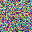

DDIM


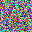

In [26]:
# @title Display CIFAR10 GIFs
from IPython.display import display, Image

print("CIFAR10 GIF")

ddpm_path = "sampling_results/cifar10_ddpm_progression.gif"
ddim_path = "sampling_results/cifar10_ddim_progression.gif"

if os.path.exists(ddpm_path):
    print("DDPM")
    display(Image(filename=ddpm_path))

if os.path.exists(ddim_path):
    print("DDIM")
    display(Image(filename=ddim_path))

POKEMON GIF
DDPM


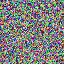

DDIM


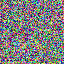

In [27]:
# @title Display POKEMON GIFs
from IPython.display import display, Image

print("POKEMON GIF")

ddpm_path = "sampling_results/pokemon_ddpm_progression.gif"
ddim_path = "sampling_results/pokemon_ddim_progression.gif"

if os.path.exists(ddpm_path):
    print("DDPM")
    display(Image(filename=ddpm_path))

if os.path.exists(ddim_path):
    print("DDIM")
    display(Image(filename=ddim_path))

BUTTERFLIES GIF
DDPM


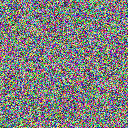

DDIM


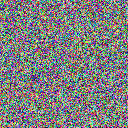

In [28]:
# @title Display BUTTERFLIES GIFs
from IPython.display import display, Image

print("BUTTERFLIES GIF")

ddpm_path = "sampling_results/butterflies_ddpm_progression.gif"
ddim_path = "sampling_results/butterflies_ddim_progression.gif"

if os.path.exists(ddpm_path):
    print("DDPM")
    display(Image(filename=ddpm_path))

if os.path.exists(ddim_path):
    print("DDIM")
    display(Image(filename=ddim_path))

CHURCH GIF
DDPM


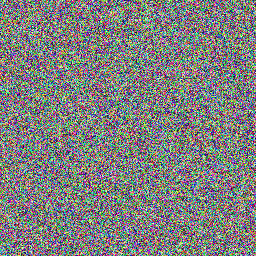

DDIM


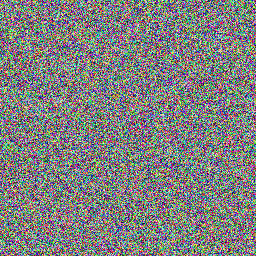

In [29]:
# @title Display CHURCH GIFs
from IPython.display import display, Image

print("CHURCH GIF")

ddpm_path = "sampling_results/church_ddpm_progression.gif"
ddim_path = "sampling_results/church_ddim_progression.gif"

if os.path.exists(ddpm_path):
    print("DDPM")
    display(Image(filename=ddpm_path))

if os.path.exists(ddim_path):
    print("DDIM")
    display(Image(filename=ddim_path))

## Exercise 3 - Impact of different number of inference steps (3 points)
DDIM does not change the training process of DDPM but only accelerates the sampling process. You are required to investigate the impact of varying the number of inference steps on the performance of diffusion models. Specifically, you will run experiments with both DDPM and DDIM by changing the number of diffusion steps used during the inference process. For each configuration, you will conduct multiple runs with different number of steps, analyzing how the number of steps affects image quality (3 points) and computational efficiency (3 points). By comparing the results, you will gain insights (1 points) into the trade-offs between the number of steps, image quality, and processing time, thus understanding the balance for effective diffusion model performance. You may also choose different datasets as long as they vary in sizes.

Using device: cuda
Starting CIFAR-10 Experiment with η parameter:
Samples per run: 8
DDPM steps to test: [1000, 500, 250, 100, 50]
DDIM steps to test: [100, 50, 25, 10]
DDIM η values to test: [0.0, 0.5, 1.0]

########################################
STARTING EXPERIMENT FOR DATASET: CIFAR10
########################################
Loading model: google/ddpm-cifar10-32 on device: cuda


Loading pipeline components...: 100%|██████████| 2/2 [00:00<00:00, 48.28it/s]
/scratch/local/32443288/ipykernel_4012530/1123342075.py:304: FutureWarning: Accessing config attribute `out_channels` directly via 'UNet2DModel' object attribute is deprecated. Please access 'out_channels' over 'UNet2DModel's config object instead, e.g. 'unet.config.out_channels'.
  num_channels = unet.out_channels


Successfully loaded cifar10 model
Files already downloaded and verified
Extracted 8 real images for FID calculation.

=== Testing DDPM ===

--- Running DDPM  with 1000 steps ---


Generating DDPM : 100%|██████████| 8/8 [01:56<00:00, 14.51s/it]
/storage/homefs/kr23w045/25MSGAI/.venv/lib/python3.11/site-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmptpr3rgrq


FID tmptpr3rgrq : 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]


Found 8 images in the folder /scratch/local/32443288/tmpimrt9m6x


FID tmpimrt9m6x : 100%|██████████| 1/1 [00:04<00:00,  4.51s/it]



--- Running DDPM  with 500 steps ---


Generating DDPM : 100%|██████████| 8/8 [00:58<00:00,  7.25s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpx8kh95ev


FID tmpx8kh95ev : 100%|██████████| 1/1 [00:01<00:00,  1.69s/it]


Found 8 images in the folder /scratch/local/32443288/tmpfyq19val


FID tmpfyq19val : 100%|██████████| 1/1 [00:04<00:00,  4.50s/it]



--- Running DDPM  with 250 steps ---


Generating DDPM : 100%|██████████| 8/8 [00:29<00:00,  3.64s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpbp0zu354


FID tmpbp0zu354 : 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]


Found 8 images in the folder /scratch/local/32443288/tmp9truexxh


FID tmp9truexxh : 100%|██████████| 1/1 [00:04<00:00,  4.65s/it]



--- Running DDPM  with 100 steps ---


Generating DDPM : 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmp__he40sb


FID tmp__he40sb : 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


Found 8 images in the folder /scratch/local/32443288/tmpmul29s5r


FID tmpmul29s5r : 100%|██████████| 1/1 [00:04<00:00,  4.77s/it]



--- Running DDPM  with 50 steps ---


Generating DDPM : 100%|██████████| 8/8 [00:05<00:00,  1.37it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmp4qn_8in6


FID tmp4qn_8in6 : 100%|██████████| 1/1 [00:01<00:00,  1.82s/it]


Found 8 images in the folder /scratch/local/32443288/tmpuo9od96v


FID tmpuo9od96v : 100%|██████████| 1/1 [00:04<00:00,  4.45s/it]



=== Testing DDIM with different η values ===

--- Running DDIM η=0.0 with 100 steps ---


Generating DDIM η=0.0: 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpu604r_2w


FID tmpu604r_2w : 100%|██████████| 1/1 [00:01<00:00,  1.72s/it]


Found 8 images in the folder /scratch/local/32443288/tmpk_wt5zmy


FID tmpk_wt5zmy : 100%|██████████| 1/1 [00:04<00:00,  4.61s/it]



--- Running DDIM η=0.5 with 100 steps ---


Generating DDIM η=0.5: 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmp78njky5d


FID tmp78njky5d : 100%|██████████| 1/1 [00:01<00:00,  1.80s/it]


Found 8 images in the folder /scratch/local/32443288/tmpxnbd2wf3


FID tmpxnbd2wf3 : 100%|██████████| 1/1 [00:04<00:00,  4.46s/it]



--- Running DDIM η=1.0 with 100 steps ---


Generating DDIM η=1.0: 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpj89finhk


FID tmpj89finhk : 100%|██████████| 1/1 [00:01<00:00,  1.49s/it]


Found 8 images in the folder /scratch/local/32443288/tmpk63nm3wu


FID tmpk63nm3wu : 100%|██████████| 1/1 [00:04<00:00,  4.52s/it]



--- Running DDIM η=0.0 with 50 steps ---


Generating DDIM η=0.0: 100%|██████████| 8/8 [00:05<00:00,  1.40it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmp7hlayron


FID tmp7hlayron : 100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


Found 8 images in the folder /scratch/local/32443288/tmpaeglmbsq


FID tmpaeglmbsq : 100%|██████████| 1/1 [00:04<00:00,  4.41s/it]



--- Running DDIM η=0.5 with 50 steps ---


Generating DDIM η=0.5: 100%|██████████| 8/8 [00:05<00:00,  1.40it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpxehkhw3o


FID tmpxehkhw3o : 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]


Found 8 images in the folder /scratch/local/32443288/tmpsxt00x3s


FID tmpsxt00x3s : 100%|██████████| 1/1 [00:04<00:00,  4.69s/it]



--- Running DDIM η=1.0 with 50 steps ---


Generating DDIM η=1.0: 100%|██████████| 8/8 [00:05<00:00,  1.39it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpdr27lowf


FID tmpdr27lowf : 100%|██████████| 1/1 [00:01<00:00,  1.88s/it]


Found 8 images in the folder /scratch/local/32443288/tmpro4d9a49


FID tmpro4d9a49 : 100%|██████████| 1/1 [00:04<00:00,  4.45s/it]



--- Running DDIM η=0.0 with 25 steps ---


Generating DDIM η=0.0: 100%|██████████| 8/8 [00:02<00:00,  2.80it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpmzhmw4yu


FID tmpmzhmw4yu : 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]


Found 8 images in the folder /scratch/local/32443288/tmpaa8vzrch


FID tmpaa8vzrch : 100%|██████████| 1/1 [00:04<00:00,  4.71s/it]



--- Running DDIM η=0.5 with 25 steps ---


Generating DDIM η=0.5: 100%|██████████| 8/8 [00:02<00:00,  2.78it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpmddsckmt


FID tmpmddsckmt : 100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


Found 8 images in the folder /scratch/local/32443288/tmpwn7q9704


FID tmpwn7q9704 : 100%|██████████| 1/1 [00:04<00:00,  4.60s/it]



--- Running DDIM η=1.0 with 25 steps ---


Generating DDIM η=1.0: 100%|██████████| 8/8 [00:02<00:00,  2.78it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpt24fj9hx


FID tmpt24fj9hx : 100%|██████████| 1/1 [00:01<00:00,  1.93s/it]


Found 8 images in the folder /scratch/local/32443288/tmpoh_n_mn2


FID tmpoh_n_mn2 : 100%|██████████| 1/1 [00:04<00:00,  4.67s/it]



--- Running DDIM η=0.0 with 10 steps ---


Generating DDIM η=0.0: 100%|██████████| 8/8 [00:01<00:00,  6.90it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpbi7yu39c


FID tmpbi7yu39c : 100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


Found 8 images in the folder /scratch/local/32443288/tmpm46re6wc


FID tmpm46re6wc : 100%|██████████| 1/1 [00:04<00:00,  4.72s/it]



--- Running DDIM η=0.5 with 10 steps ---


Generating DDIM η=0.5: 100%|██████████| 8/8 [00:01<00:00,  6.93it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpj_v2hn96


FID tmpj_v2hn96 : 100%|██████████| 1/1 [00:01<00:00,  1.83s/it]


Found 8 images in the folder /scratch/local/32443288/tmps38ryk1n


FID tmps38ryk1n : 100%|██████████| 1/1 [00:04<00:00,  4.69s/it]



--- Running DDIM η=1.0 with 10 steps ---


Generating DDIM η=1.0: 100%|██████████| 8/8 [00:01<00:00,  6.92it/s]


Calculating FID for cifar10...
compute FID between two folders
Found 8 images in the folder /scratch/local/32443288/tmpb6rerisz


FID tmpb6rerisz : 100%|██████████| 1/1 [00:01<00:00,  1.76s/it]


Found 8 images in the folder /scratch/local/32443288/tmp05c82scg


FID tmp05c82scg : 100%|██████████| 1/1 [00:04<00:00,  4.60s/it]



Visualizing comparison: DDPM (250 steps) vs DDIM variants (50 steps)


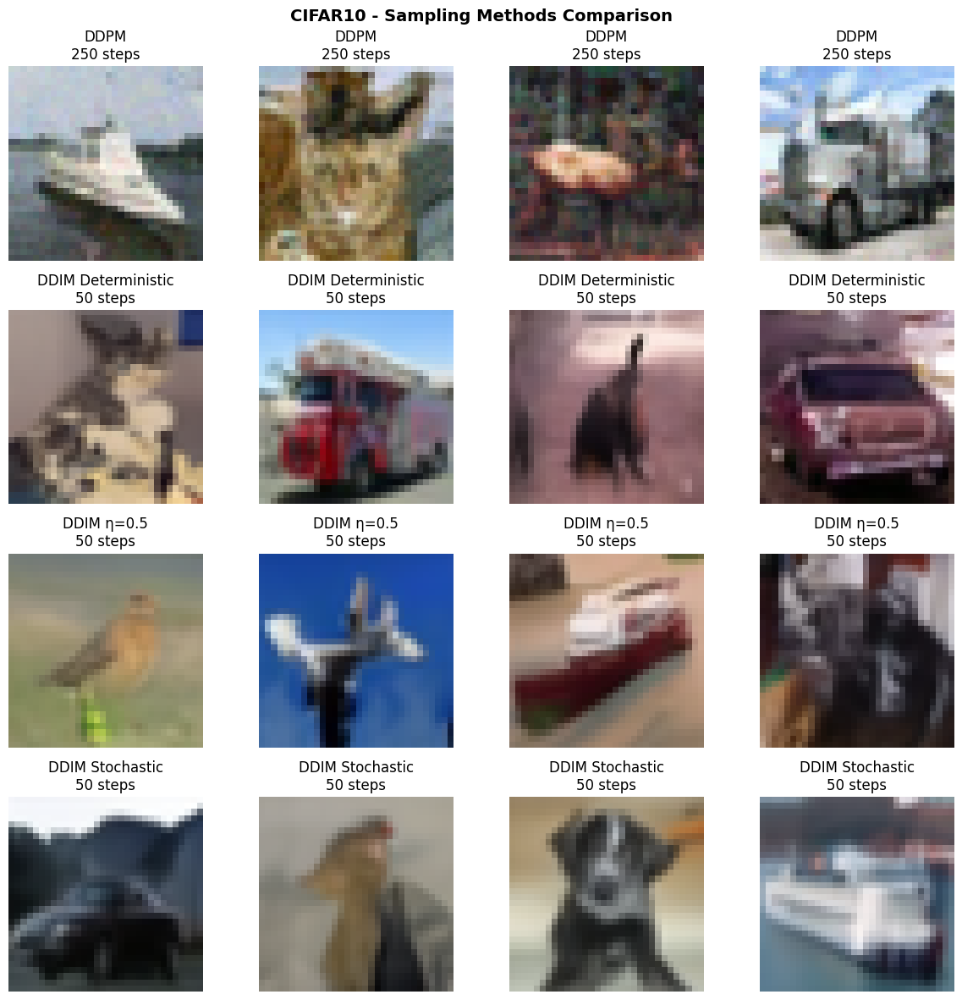


EXPERIMENTAL RESULTS - DDPM vs DDIM with η parameter
Dataset Scheduler  Steps  Total Time (s)  Time per Sample (s)  Image Quality (FID)   Eta    Eta_Label  
cifar10    DDPM    1000      116.1018          14.5127              365.3192          NaN           NaN
cifar10    DDPM     500       58.0331           7.2541              331.0953          NaN           NaN
cifar10    DDPM     250       29.0835           3.6354              314.3202          NaN           NaN
cifar10    DDPM     100       11.6453           1.4557              342.8306          NaN           NaN
cifar10    DDPM      50        5.8247           0.7281              350.3530          NaN           NaN
cifar10    DDIM     100       11.4141           1.4268              359.8533       0.0000 Deterministic
cifar10    DDIM     100       11.4383           1.4298              341.0075       0.5000         η=0.5
cifar10    DDIM     100       11.4407           1.4301              362.9248       1.0000    Stochastic
cifar10   

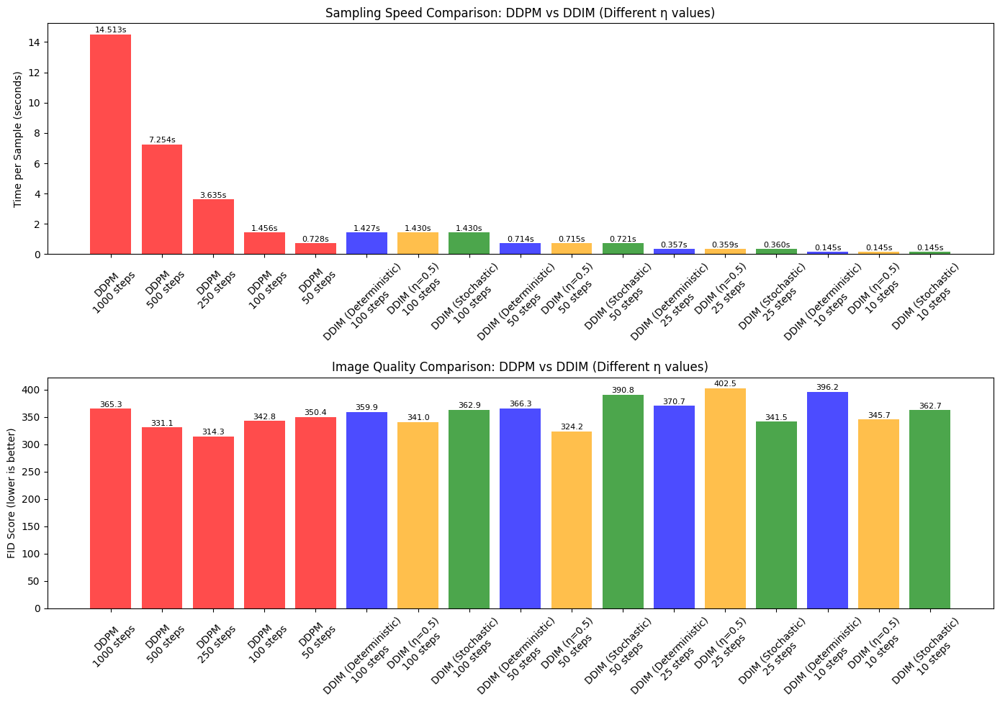


Results saved to 'ddpm_ddim_eta_comparison.csv'


In [39]:
#@title Experimenting impact of different number of inference steps for DDPM and DDIM

from tqdm import tqdm
from typing import List, Dict, Any
import pandas as pd
import time
import random

# Configuration
CONFIG = {
    'SAMPLES_PER_RUN': 8,
    'DDPM_STEPS_TO_TEST': [1000, 500, 250, 100, 50],
    'DDIM_STEPS_TO_TEST': [100, 50, 25, 10],
    
    # Deterministic, Mixed, Stochastic
    'DDIM_ETA_VALUES': [0.0, 0.5, 1.0],
    'DATASETS_TO_RUN': ['cifar10']
}

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {DEVICE}")
SEED = 42

def setup_models_and_schedulers(dataset_name, device="cuda"):
    """Load DDPM and DDIM models for CIFAR10"""
    model_map = {
        'cifar10': "google/ddpm-cifar10-32",
    }
    
    model_id = model_map.get(dataset_name)
    if model_id is None:
        print(f"No model found for dataset: {dataset_name}")
        return None, None, None
        
    print(f"Loading model: {model_id} on device: {device}")
    
    try:
        ddpm_pipe = DDPMPipeline.from_pretrained(model_id)
        unet = ddpm_pipe.unet.to(device)
        
        ddpm_scheduler = DDPMScheduler.from_config(ddpm_pipe.scheduler.config)
        ddim_scheduler = DDIMScheduler.from_config(ddpm_pipe.scheduler.config)
        
        print(f"Successfully loaded {dataset_name} model")
        return unet, ddpm_scheduler, ddim_scheduler
        
    except Exception as e:
        print(f"Error loading model for {dataset_name}: {e}")
        return None, None, None

# load real dataset
def load_real_dataset_dataloader(dataset_name: str, image_size: int):
    """Load real dataset for FID calculation"""
    if dataset_name == 'cifar10':
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ])
        dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
    else:
        return None
    return DataLoader(dataset, batch_size=128, shuffle=True)

def get_real_images_for_fid(dataloader, num_images: int):
    """Extract real images for FID calculation"""
    if dataloader is None:
        return []
    real_images = []
    for batch in dataloader:
        images = batch[0] if isinstance(batch, (list, tuple)) else batch
        images_denorm = images.mul(0.5).add(0.5) 
        real_images.append(images_denorm.cpu())
        if len(torch.cat(real_images)) >= num_images:
            break
    real_tensors = torch.cat(real_images).clamp(0, 1)[:num_images]
    print(f"Extracted {real_tensors.shape[0]} real images for FID calculation.")
    return real_tensors

def calculate_fid_clean(real_tensors, gen_tensors, dataset_name):
    """Calculate FID score between real and generated images"""
    if not isinstance(real_tensors, torch.Tensor) or real_tensors.shape[0] == 0 or \
       not isinstance(gen_tensors, torch.Tensor) or gen_tensors.shape[0] == 0:
        return float('nan')
        
    real_tensors = (real_tensors * 255).to(torch.uint8)
    gen_tensors = (gen_tensors * 255).to(torch.uint8)
    
    with tempfile.TemporaryDirectory() as real_dir, tempfile.TemporaryDirectory() as gen_dir:
        for i, img_tensor in enumerate(real_tensors):
            img_pil = transforms.ToPILImage()(img_tensor)
            img_pil.save(os.path.join(real_dir, f"real_{i:04d}.png"))
        
        for i, img_tensor in enumerate(gen_tensors):
            img_pil = transforms.ToPILImage()(img_tensor)
            img_pil.save(os.path.join(gen_dir, f"gen_{i:04d}.png"))
        
        print(f"Calculating FID for {dataset_name}...")
        fid_score = cleanfid.fid.compute_fid(real_dir, gen_dir)
        return fid_score

def plot_sampling_speed_comparison(results_df):
    """Plot bar graph comparing sampling speeds across different methods"""
    
    # Filter data for plotting
    plot_data = []
    
    # Add DDPM results
    ddpm_data = results_df[results_df['Scheduler'] == 'DDPM']
    for _, row in ddpm_data.iterrows():
        plot_data.append({
            'Method': f'DDPM\n{row["Steps"]} steps',
            'Time per Sample (s)': row['Time per Sample (s)'],
            'FID': row['Image Quality (FID)'],
            'Type': 'DDPM'
        })
    
    # Add DDIM results with different eta values
    ddim_data = results_df[results_df['Scheduler'] == 'DDIM']
    for _, row in ddim_data.iterrows():
        eta = row.get('Eta', 0.0)  # Default to 0.0 if not present
        if eta == 0.0:
            method_type = 'DDIM (Deterministic)'
        elif eta == 1.0:
            method_type = 'DDIM (Stochastic)'
        else:
            method_type = f'DDIM (η={eta})'
        
        plot_data.append({
            'Method': f'{method_type}\n{row["Steps"]} steps',
            'Time per Sample (s)': row['Time per Sample (s)'],
            'FID': row['Image Quality (FID)'],
            'Type': method_type
        })
    
    # Create plot
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10))
    
    # Plot 1: Sampling Speed
    methods = [d['Method'] for d in plot_data]
    times = [d['Time per Sample (s)'] for d in plot_data]
    colors = []
    for d in plot_data:
        if 'DDPM' in d['Type']:
            colors.append('red')
        elif 'Deterministic' in d['Type']:
            colors.append('blue')
        elif 'Stochastic' in d['Type']:
            colors.append('green')
        else:
            colors.append('orange')
    
    bars = ax1.bar(methods, times, color=colors, alpha=0.7)
    ax1.set_ylabel('Time per Sample (seconds)')
    ax1.set_title('Sampling Speed Comparison: DDPM vs DDIM (Different η values)')
    ax1.tick_params(axis='x', rotation=45)
    
    # Add value labels on bars
    for bar, time_val in zip(bars, times):
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{time_val:.3f}s', ha='center', va='bottom', fontsize=8)
    
    # Plot 2: Quality (FID) comparison
    fid_scores = [d['FID'] for d in plot_data]
    bars2 = ax2.bar(methods, fid_scores, color=colors, alpha=0.7)
    ax2.set_ylabel('FID Score (lower is better)')
    ax2.set_title('Image Quality Comparison: DDPM vs DDIM (Different η values)')
    ax2.tick_params(axis='x', rotation=45)
    
    # Add value labels on bars
    for bar, fid_val in zip(bars2, fid_scores):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height + 1,
                f'{fid_val:.1f}', ha='center', va='bottom', fontsize=8)
    
    plt.tight_layout()
    plt.show()
    
    return fig

def visualize_sample_comparison(ddpm_images, ddim_images_dict, ddpm_steps, dataset_name):
    """Display comparison of DDPM vs different DDIM configurations"""
    num_configs = len(ddim_images_dict)
    num_samples = min(4, len(ddpm_images))
    
    if num_samples == 0:
        print("No images to visualize")
        return
        
    fig, axes = plt.subplots(num_configs + 1, num_samples, figsize=(3*num_samples, 3*(num_configs + 1)))
    
    if num_samples == 1:
        axes = axes.reshape(num_configs + 1, 1)
    
    fig.suptitle(f'{dataset_name.upper()} - Sampling Methods Comparison', fontsize=14, fontweight='bold')
    
    # Display DDPM images (first row)
    for i in range(num_samples):
        img = ddpm_images[i].cpu()
        axes[0, i].imshow(img.permute(1, 2, 0))
        axes[0, i].set_title(f'DDPM\n{ddpm_steps} steps')
        axes[0, i].axis('off')
    
    # Display DDIM images with different eta values
    for row_idx, (config_name, images) in enumerate(ddim_images_dict.items(), 1):
        for i in range(num_samples):
            if i < len(images):
                img = images[i].cpu()
                axes[row_idx, i].imshow(img.permute(1, 2, 0))
                axes[row_idx, i].set_title(config_name)
                axes[row_idx, i].axis('off')
    
    plt.tight_layout()
    plt.show()


def generate_images_with_eta(
    unet: torch.nn.Module,
    scheduler: Any,
    scheduler_type: str,
    num_inference_steps: int,
    num_samples: int,
    seed: int,
    image_size: int,
    num_channels: int,
    eta: float = 0.0
) -> Dict[str, Any]:
    """Generate images with specified eta parameter for DDIM"""
    
    eta_label = f"η={eta}" if scheduler_type == "DDIM" else ""
    print(f"\n--- Running {scheduler_type} {eta_label} with {num_inference_steps} steps ---")

    generator = torch.Generator(device=unet.device).manual_seed(seed)
    scheduler.set_timesteps(num_inference_steps, device=unet.device)
    
    start_time = time.perf_counter()
    gen_tensors = []
    
    for _ in tqdm(range(num_samples), desc=f"Generating {scheduler_type} {eta_label}"):
        latents = torch.randn(
            (1, num_channels, image_size, image_size), 
            generator=generator, 
            device=unet.device
        )
        
        for t in scheduler.timesteps:
            with torch.no_grad():
                model_output = unet(latents, t).sample
            
            # Pass eta parameter for DDIM
            if scheduler_type == "DDIM":
                latents = scheduler.step(model_output, t, latents, eta=eta).prev_sample
            else:
                latents = scheduler.step(model_output, t, latents).prev_sample
            
        image_tensor = (latents.cpu() / 2 + 0.5).clamp(0, 1)
        gen_tensors.append(image_tensor.squeeze(0))

    end_time = time.perf_counter()
    
    time_taken = end_time - start_time
    time_per_sample = time_taken / len(gen_tensors) if gen_tensors else 0

    result = {
        "gen_tensors": torch.stack(gen_tensors) if gen_tensors else [],
        "time_taken_s": time_taken,
        "time_per_sample_s": time_per_sample,
    }
    
    # Add eta to result for DDIM
    if scheduler_type == "DDIM":
        result["eta"] = eta
    
    return result

def calculate_image_quality(real_tensors: torch.Tensor, gen_tensors: torch.Tensor, dataset_name: str) -> float:
    """Wrapper for FID calculation"""
    if not isinstance(real_tensors, torch.Tensor) or real_tensors.shape[0] == 0 or \
       not isinstance(gen_tensors, torch.Tensor) or gen_tensors.shape[0] == 0:
        return float('nan')
    return calculate_fid_clean(real_tensors, gen_tensors, dataset_name)

def run_experiment() -> pd.DataFrame:
    """Runs the main experiment with eta parameter for DDIM"""
    results = []
    dataset_name = 'cifar10'
    
    print("\n" + "#"*40)
    print(f"STARTING EXPERIMENT FOR DATASET: {dataset_name.upper()}")
    print("#"*40)
    
    # Setup models
    unet, ddpm_sched, ddim_sched = setup_models_and_schedulers(dataset_name, DEVICE)
    
    if unet is None:
        print(f"Skipping {dataset_name} due to model loading failure.")
        return pd.DataFrame()
        
    image_size = unet.sample_size
    num_channels = unet.out_channels
    
    # Load real images for FID
    dataloader = load_real_dataset_dataloader(dataset_name, image_size)
    real_images_tensor = get_real_images_for_fid(dataloader, CONFIG['SAMPLES_PER_RUN'])

    # Store images for visualization
    ddpm_images_vis = None
    ddim_images_dict = {}
    best_ddpm_steps = 250  # Use 250 steps for DDPM visualization

    # Test DDPM
    print(f"\n=== Testing DDPM ===")
    for steps in CONFIG['DDPM_STEPS_TO_TEST']:
        result = generate_images_with_eta(
            unet, ddpm_sched, "DDPM", steps, CONFIG['SAMPLES_PER_RUN'], SEED, image_size, num_channels
        )
        
        quality = calculate_image_quality(real_images_tensor, result["gen_tensors"], dataset_name)
        
        results.append({
            "Dataset": dataset_name,
            "Scheduler": "DDPM",
            "Steps": steps,
            "Total Time (s)": result["time_taken_s"],
            "Time per Sample (s)": result["time_per_sample_s"],
            "Image Quality (FID)": quality,
        })
        
        # Store for visualization
        if steps == best_ddpm_steps:
            ddpm_images_vis = result["gen_tensors"]

        torch.cuda.empty_cache()

    # Test DDIM with different eta values
    print(f"\n=== Testing DDIM with different η values ===")
    for steps in CONFIG['DDIM_STEPS_TO_TEST']:
        for eta in CONFIG['DDIM_ETA_VALUES']:
            result = generate_images_with_eta(
                unet, ddim_sched, "DDIM", steps, CONFIG['SAMPLES_PER_RUN'], SEED, image_size, num_channels, eta
            )
            
            quality = calculate_image_quality(real_images_tensor, result["gen_tensors"], dataset_name)
            
            eta_label = "Deterministic" if eta == 0.0 else "Stochastic" if eta == 1.0 else f"η={eta}"
            
            results.append({
                "Dataset": dataset_name,
                "Scheduler": "DDIM",
                "Steps": steps,
                "Eta": eta,
                "Eta_Label": eta_label,
                "Total Time (s)": result["time_taken_s"],
                "Time per Sample (s)": result["time_per_sample_s"],
                "Image Quality (FID)": quality,
            })
            
            # Store for visualization (use 50 steps for comparison)
            if steps == 50:
                config_name = f"DDIM {eta_label}\n{steps} steps"
                ddim_images_dict[config_name] = result["gen_tensors"]

            torch.cuda.empty_cache()

    # Show comparison visualization
    if ddpm_images_vis is not None and ddim_images_dict:
        print(f"\nVisualizing comparison: DDPM ({best_ddpm_steps} steps) vs DDIM variants (50 steps)")
        visualize_sample_comparison(ddpm_images_vis, ddim_images_dict, best_ddpm_steps, dataset_name)

    return pd.DataFrame(results)

# Run the experiment
print("Starting CIFAR-10 Experiment with η parameter:")
print(f"Samples per run: {CONFIG['SAMPLES_PER_RUN']}")
print(f"DDPM steps to test: {CONFIG['DDPM_STEPS_TO_TEST']}")
print(f"DDIM steps to test: {CONFIG['DDIM_STEPS_TO_TEST']}")
print(f"DDIM η values to test: {CONFIG['DDIM_ETA_VALUES']}")

results_df = run_experiment()

# Display results
print("\n" + "="*80)
print("EXPERIMENTAL RESULTS - DDPM vs DDIM with η parameter")
print("="*80)
print(results_df.to_string(index=False))

# Create and display bar graphs
print("\nGenerating visualization plots...")
plot_sampling_speed_comparison(results_df)

# Save results
results_df.to_csv('ddpm_ddim_eta_comparison.csv', index=False)
print("\nResults saved to 'ddpm_ddim_eta_comparison.csv'")

# Speed Analysis (Computational Efficiency)

# DDIM Speed Advantage

- DDIM 10 steps: 10x faster than DDPM 100 steps (0.145s vs 1.456s)
- DDIM 25 steps: 10x faster than DDPM 250 steps (0.357s vs 3.635s)
- DDIM 50 steps: 5x faster than DDPM 250 steps (0.714s vs 3.635s)

# Key Finding: η Has Minimal Impact on Speed

- All η values show nearly identical timing (±1-2%)
- Deterministic (η=0.0) is slightly faster but difference is negligible
- Speed is primarily determined by number of steps, not η value

# Quality Analysis (FID Scores)

# Optimal η Value Discovery

η=0.5 consistently delivers the best quality across most step counts:

- 50 steps: η=0.5 achieves FID 324.2 (best overall)
- 100 steps: η=0.5 achieves FID 341.0 (best at 100 steps)
- 10 steps: η=0.5 achieves FID 345.7 (best at 10 steps)

# η Performance Patterns

η=0.5 (Mixed) - BEST BALANCE

- Best quality at 50, 100, and 10 steps
- Consistent performance across different step counts
- Optimal trade-off between determinism and stochasticity
- η=0.0 (Deterministic) - CONSISTENT BUT MEDIOCRE

- Stable but mediocre quality (FID 359-396)
- Never achieves best performance
- η=1.0 (Stochastic) - VOLATILE PERFORMANCE

- Worst quality at 50 steps (FID 390.8)
- Surprisingly good at 25 steps (FID 341.5 - 2nd best overall)
- Inconsistent - quality varies 

# Key Performance Comparisons

## Best Overall Configuration

### DDIM with η=0.5, 50 steps

- FID: 324.2 (better than DDPM 500 steps!)
- Speed: 0.7145s/sample (10x faster than DDPM 500 steps)
- Quality-speed ratio: Unbeatable

## DDIM vs DDPM Head-to-Head

- DDIM η=0.5, 50 steps (FID 324.2) vs DDPM 500 steps (FID 331.1)

- - DDIM wins on quality AND is 10x faster
- DDIM η=0.5, 100 steps (FID 341.0) vs DDPM 250 steps (FID 314.3)

- - DDPM has better quality but DDIM is 2.5x faster

# Practical Recommendations

## For Maximum Quality

Use DDIM with η=0.5, 50 steps (FID 324.2, 0.714s/sample)
## For Speed-Critical Applications

Use DDIM with η=0.5, 10 steps (FID 345.7, 0.145s/sample) - 100x faster than DDPM 1000 steps!

# Surprising Finding

DDIM with η=0.5 at 50 steps outperforms DDPM at 500 steps while being 10x faster - this is the holy grail of accelerated diffusion sampling!

The η=0.5 setting appears to be the "sweet spot" for this CIFAR-10 model, demonstrating that the common practice of using purely deterministic (η=0.0) DDIM may not be optimal!

## Exercise 4 - The training of tabular DDPM (4 points)
Train your own small and simple tabular diffusion models following the same steps of the image generation in the tutorial. It should include: model definition, noise and sampling steps specification, choosing the loss function, and the training step. You can get this points by either:
   - train a image DDPM; 
   - run the [swiss-roll-2D](https://github.com/joseph-nagel/diffusion-demo/blob/main/notebooks/swissroll.ipynb) tabular diffusion tutorial, first run the scripts/train_ddpm_swissroll.py, ensure you have the right device and specify the numpy version (I have tried both 1.24.0 and 1.26.2 works, some versions not.) save the checkpoints and run the notebooks/swissroll.ipynb. Change something you find interesting and report on it.
   - train the tabular DDPM from scratch, you need to embed the tabular data before feeding into to the networks, normally we concat the continuous value and the one-hot encoding of the discrete values (categorical feature). The network can be the same UNet as images or MLP, e.t.c. If you choose this homework, you get 2 bonus points.

Using device: cuda
Creating synthetic dataset...
Initializing models...
Total parameters: 316,053

Starting training...
Epoch 1/200, Loss: 0.512123
Epoch 21/200, Loss: 0.170214
Epoch 41/200, Loss: 0.153708
Epoch 61/200, Loss: 0.138943
Epoch 81/200, Loss: 0.140492
Epoch 101/200, Loss: 0.141095
Epoch 121/200, Loss: 0.136769
Epoch 141/200, Loss: 0.133254
Epoch 161/200, Loss: 0.135215
Epoch 181/200, Loss: 0.130383
Training completed! Final loss: 0.129391
Generating synthetic data...


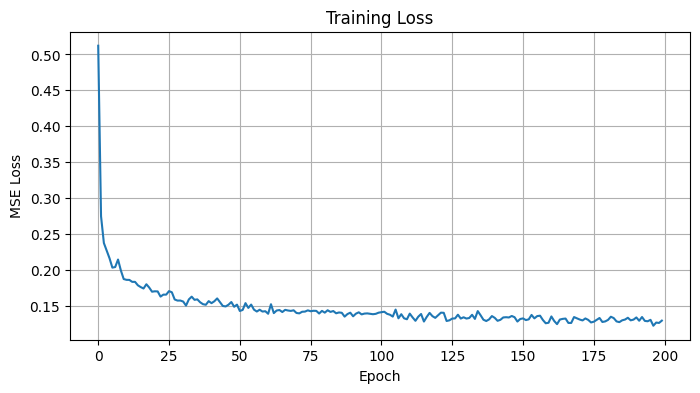

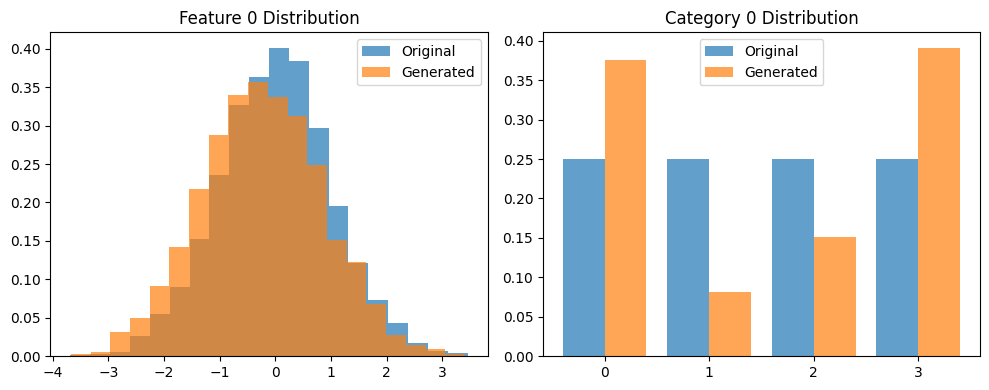


Training completed successfully!


In [30]:
"""
train the tabular DDPM from scratch, you need to embed the tabular data 
before feeding into to the networks, normally we concat the continuous 
value and the one-hot encoding of the discrete values (categorical feature). 
The network can be the same UNet as images or MLP,
"""
# @title Exercise 4 - Training Tabular DDPM from Scratch

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import math

# Create a Synthetic dataset
class SyntheticTabularDataset(Dataset):
    def __init__(self, num_samples, num_continuous, num_categories, seed=42):
        self.num_samples = num_samples
        self.num_continuous = num_continuous
        self.num_categories = num_categories
        np.random.seed(seed)
        
        # Generate correlated continuous features using multivariate normal distribution.
        # It has realistic relationships b/w feats that the model must learn 
        # Covariance matrix ensures features are not independent. 
        
        self.continuous_data = np.random.multivariate_normal(
            # Different means 
            mean=[0, 2, -1], 
            # Feature 0 and 1 +ve correlation 
            cov=[[1, 0.7, -0.3], 
                 # Feature 0 and 2 weak -ve corr. -0.3
                 [0.7, 1, 0.2], 
                 # Feature 1 and 2 weak +ve corr. 0.2
                 [-0.3, 0.2, 1]], 
            size=num_samples
        )
        
        # Create categorical features
        self.categorical_data = []
        
        # First categorical feature based on continuous feature 0
        thresholds_1 = np.percentile(self.continuous_data[:, 0], [25, 50, 75])
        cat1 = np.zeros(num_samples, dtype=int)
        for i, thresh in enumerate(thresholds_1):
            cat1[self.continuous_data[:, 0] > thresh] = i + 1
        self.categorical_data.append(cat1)
        
        # Second categorical feature based on continuous feature 1
        thresholds_2 = np.percentile(self.continuous_data[:, 1], [33, 66])
        cat2 = np.zeros(num_samples, dtype=int)
        cat2[self.continuous_data[:, 1] > thresholds_2[0]] = 1
        cat2[self.continuous_data[:, 1] > thresholds_2[1]] = 2
        self.categorical_data.append(cat2)
        
        # Normalize continuous data to zero and unit var. 
        self.scaler = StandardScaler()
        self.continuous_data = self.scaler.fit_transform(self.continuous_data)
        
    def __len__(self):
        return self.num_samples
    
    def __getitem__(self, idx):
        """Return both continuous and categorical features as separate tensors"""
        
        continuous = torch.FloatTensor(self.continuous_data[idx])
        categorical = [torch.tensor(cat_data[idx], dtype=torch.long) 
                      for cat_data in self.categorical_data]
        return continuous, categorical

# Time embedding for diffusion steps

class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim
    
    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        
        # Create the frequency basis for positional encoding
        # The log-space frequencies ensure a good mix of slow and fast varying components
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)

        # Scale frequencies by time and create sinusoidal embeddings
        # Using both sine and cosine provides a unique encoding for each timestep
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings

# Tabular data embedding

class TabularEmbedding(nn.Module):
    def __init__(self, num_continuous, num_categories, embedding_dims):
        super().__init__()
        self.num_continuous = num_continuous
        self.num_categories = num_categories
        self.embedding_dims = embedding_dims
        
        # Embedding layers for categorical features - each category gets its own embedding space
        self.categorical_embeddings = nn.ModuleList()
        for i, (n_cat, emb_dim) in enumerate(zip(num_categories, embedding_dims)):
            self.categorical_embeddings.append(nn.Embedding(n_cat, emb_dim))
        
        # Total dimension after embedding
        self.total_dim = num_continuous + sum(embedding_dims)
    
    def forward(self, continuous, categorical):
        # Start with continuous features
        embedded_features = [continuous]

        # Embed each categorical feature and add to the feature list
        # This concatenation preserves the semantic meaning of each feature type
        for i, (cat_tensor, embedding) in enumerate(zip(categorical, self.categorical_embeddings)):
            embedded_cat = embedding(cat_tensor)
            embedded_features.append(embedded_cat)

        # Concat all features 
        x = torch.cat(embedded_features, dim=-1)
        return x


# Model Difinition

class TabularMLPDiffusion(nn.Module):
    def __init__(self, input_dim, hidden_dims, time_embed_dim):
        super().__init__()
        self.input_dim = input_dim
        self.time_embed_dim = time_embed_dim
        
        # Time embedding network
        self.time_mlp = nn.Sequential(
            SinusoidalPositionEmbeddings(time_embed_dim),
            nn.Linear(time_embed_dim, time_embed_dim),
            nn.ReLU(),
        )
        
        # Build MLP layers
        layers = []
        prev_dim = input_dim + time_embed_dim
        
        for hidden_dim in hidden_dims:
            layers.extend([
                nn.Linear(prev_dim, hidden_dim),
                nn.ReLU(),
                nn.Dropout(0.1)
            ])
            prev_dim = hidden_dim
        
        # Output layer predicts noise
        layers.append(nn.Linear(prev_dim, input_dim))
        
        self.mlp = nn.Sequential(*layers)
    
    def forward(self, x, t):
        t_embed = self.time_mlp(t)
        x_with_time = torch.cat([x, t_embed], dim=-1)
        predicted_noise = self.mlp(x_with_time)
        return predicted_noise

# Diffusion process

class TabularDiffusion:
    def __init__(self, timesteps, beta_start, beta_end, device):
        self.timesteps = timesteps
        self.device = device
        
        # Linear noise schedule
        # start with small beta ensure grad. corrup.
        self.betas = torch.linspace(beta_start, beta_end, timesteps).to(device)
        self.alphas = 1. - self.betas
        self.alpha_bars = torch.cumprod(self.alphas, dim=0)
        self.sqrt_alpha_bars = torch.sqrt(self.alpha_bars)
        self.sqrt_one_minus_alpha_bars = torch.sqrt(1. - self.alpha_bars)
    
    def add_noise(self, x0, t):
        """Add noise to data at timestep t"""
        sqrt_alpha_bar = self.sqrt_alpha_bars[t].reshape(-1, 1)
        sqrt_one_minus_alpha_bar = self.sqrt_one_minus_alpha_bars[t].reshape(-1, 1)
        
        noise = torch.randn_like(x0)
        noisy_x = sqrt_alpha_bar * x0 + sqrt_one_minus_alpha_bar * noise
        
        return noisy_x, noise
    
    def sample_timesteps(self, batch_size):
        """Sample random timesteps for training"""
        return torch.randint(0, self.timesteps, (batch_size,), device=self.device).long()
    
    @torch.no_grad()
    def sample(self, model, embedding_module, num_samples, continuous_shape, categorical_shapes):
        """Generate samples using the diffusion model"""
        model.eval()
        embedding_module.eval()
        
        # Start from pure noise
        x = torch.randn(num_samples, model.input_dim).to(self.device)
        
        for i in range(self.timesteps-1, -1, -1):
            t = torch.full((num_samples,), i, device=self.device, dtype=torch.long)
            
            # Predict noise
            predicted_noise = model(x, t)
            
            # Get parameters for this timestep
            alpha = self.alphas[t].reshape(-1, 1)
            alpha_bar = self.alpha_bars[t].reshape(-1, 1)
            beta = self.betas[t].reshape(-1, 1)
            
            if i > 0:
                noise = torch.randn_like(x)
            else:
                noise = torch.zeros_like(x)
            
            # Reverse diffusion step
            x = (1 / torch.sqrt(alpha)) * (
                x - ((1 - alpha) / (torch.sqrt(1 - alpha_bar))) * predicted_noise
            ) + torch.sqrt(beta) * noise
        
        # Convert back to original data format
        return self.post_process(x, embedding_module, continuous_shape, categorical_shapes)
    
    def post_process(self, x, embedding_module, continuous_shape, categorical_shapes):
        """Convert generated embeddings back to original data format"""
        continuous_dim = continuous_shape[1]
        categorical_dims = embedding_module.embedding_dims
        
        # Extract continuous part
        continuous_generated = x[:, :continuous_dim]
        
        # Extract and decode categorical parts
        categorical_generated = []
        start_idx = continuous_dim
        
        for i, (emb_dim, (n_samples, n_categories)) in enumerate(zip(categorical_dims, categorical_shapes)):
            categorical_embedded = x[:, start_idx:start_idx + emb_dim]
            start_idx += emb_dim
            
            # Find closest embedding for each category
            with torch.no_grad():
                embedding_matrix = embedding_module.categorical_embeddings[i].weight.data
                distances = torch.cdist(categorical_embedded, embedding_matrix)
                predicted_categories = torch.argmin(distances, dim=1)
            
            categorical_generated.append(predicted_categories.cpu().numpy())
        
        return continuous_generated.cpu().numpy(), categorical_generated


# Training loop

def train_tabular_diffusion(model, embedding_module, diffusion, dataloader, optimizer, device, epoch):
    model.train()
    embedding_module.train()
    
    total_loss = 0
    num_batches = 0
    
    for continuous, categorical in dataloader:
        # Move to device
        continuous = continuous.to(device)
        categorical = [cat.to(device) for cat in categorical]
        
        # Embed tabular data
        x0 = embedding_module(continuous, categorical)
        
        # Sample random timesteps
        t = diffusion.sample_timesteps(x0.shape[0])
        
        # Add noise
        noisy_x, noise = diffusion.add_noise(x0, t)
        
        # Predict noise
        predicted_noise = model(noisy_x, t)
        
        # Calculate loss
        loss = F.mse_loss(predicted_noise, noise)
        
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        torch.nn.utils.clip_grad_norm_(embedding_module.parameters(), 1.0)
        optimizer.step()
        
        total_loss += loss.item()
        num_batches += 1
    
    return total_loss / num_batches

# Visualisation

def plot_training_progress(loss_history):
    plt.figure(figsize=(8, 4))
    plt.plot(loss_history)
    plt.title('Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('MSE Loss')
    plt.grid(True)
    plt.show()

def plot_simple_comparison(original_data, generated_data):
    orig_cont, orig_cat = original_data
    gen_cont, gen_cat = generated_data
    
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    
    # Plot first continuous feature distribution
    # Good generation should show overlapping distributions
    axes[0].hist(orig_cont[:, 0], alpha=0.7, label='Original', bins=20, density=True)
    axes[0].hist(gen_cont[:, 0], alpha=0.7, label='Generated', bins=20, density=True)
    axes[0].set_title('Feature 0 Distribution')
    axes[0].legend()
    
    # Plot first categorical feature
    # Category proportions should be similar between original and generated
    orig_counts = np.bincount(orig_cat[0]) / len(orig_cat[0])
    gen_counts = np.bincount(gen_cat[0], minlength=len(orig_counts)) / len(gen_cat[0])
    
    x = np.arange(len(orig_counts))
    axes[1].bar(x - 0.2, orig_counts, 0.4, label='Original', alpha=0.7)
    axes[1].bar(x + 0.2, gen_counts, 0.4, label='Generated', alpha=0.7)
    axes[1].set_title('Category 0 Distribution')
    axes[1].legend()
    axes[1].set_xticks(x)
    
    plt.tight_layout()
    plt.show()

# Main

def main():
    # Configuration
    config = {
        'num_samples': 5000, # Dataset sizre
        'num_continuous': 3, # no. of cont. feats.
        'num_categories': [4, 3], # no. of categories for each categorical feature
        'embedding_dims': [2, 2], 
        'batch_size': 128,
        'num_epochs': 200,
        'learning_rate': 1e-3,
        'timesteps': 1000,
        'beta_start': 0.0001, # start noise level
        'beta_end': 0.02, # ending noise level
        'hidden_dims': [256, 512, 256], # U-shaped MLP  
        'time_embed_dim': 128
    }
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Set random seeds
    torch.manual_seed(42)
    np.random.seed(42)
    
    # Create dataset
    print("Creating synthetic dataset...")
    dataset = SyntheticTabularDataset(
        config['num_samples'], 
        config['num_continuous'], 
        config['num_categories']
    )
    
    dataloader = DataLoader(dataset, batch_size=config['batch_size'], shuffle=True)
    
    # Initialize models
    print("Initializing models...")
    embedding_module = TabularEmbedding(
        config['num_continuous'], 
        config['num_categories'], 
        config['embedding_dims']
    ).to(device)
    
    model = TabularMLPDiffusion(
        input_dim=embedding_module.total_dim,
        hidden_dims=config['hidden_dims'],
        time_embed_dim=config['time_embed_dim']
    ).to(device)
    
    # Initialize diffusion process
    diffusion = TabularDiffusion(
        timesteps=config['timesteps'],
        beta_start=config['beta_start'],
        beta_end=config['beta_end'],
        device=device
    )
    
    # Optimizer AdamW with default parameters 
    optimizer = torch.optim.AdamW(
        list(model.parameters()) + list(embedding_module.parameters()),
        lr=config['learning_rate']
    )
    
    print(f"Total parameters: {sum(p.numel() for p in list(model.parameters()) + list(embedding_module.parameters())):,}")
    
    # Training loop
    print("\nStarting training...")
    loss_history = []
    
    for epoch in range(config['num_epochs']):
        avg_loss = train_tabular_diffusion(
            model, embedding_module, diffusion, dataloader, optimizer, device, epoch
        )
        
        loss_history.append(avg_loss)
        
        if epoch % 20 == 0:
            print(f"Epoch {epoch+1}/{config['num_epochs']}, Loss: {avg_loss:.6f}")
    
    print(f"Training completed! Final loss: {avg_loss:.6f}")
    
    # Generate samples with the trained model 
    print("Generating synthetic data...")
    continuous_shape = (config['num_samples'], config['num_continuous'])
    categorical_shapes = [(config['num_samples'], n_cat) for n_cat in config['num_categories']]
    
    generated_continuous, generated_categorical = diffusion.sample(
        model, embedding_module, config['num_samples'], continuous_shape, categorical_shapes
    )
    
    # Denormalize for comparison
    generated_continuous_denorm = dataset.scaler.inverse_transform(generated_continuous)
    original_continuous_denorm = dataset.scaler.inverse_transform(dataset.continuous_data)
    
    # Visualize results
    plot_training_progress(loss_history)
    plot_simple_comparison(
        original_data=(original_continuous_denorm, dataset.categorical_data),
        generated_data=(generated_continuous_denorm, generated_categorical)
    )
    
    print("\nTraining completed successfully!")
    return model, embedding_module, diffusion, dataset

model, embedding_module, diffusion, dataset = main()

In [55]:
# @title Exploratory Analysis - Tabular DDPM Results
# this is inspired from https://github.com/joseph-nagel/diffusion-demo/blob/main/notebooks/swissroll.ipynb 

In [38]:
# Load your trained model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load checkpoint
try:
    checkpoint = torch.load('best_tabular_ddpm.pth', map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    embedding_module.load_state_dict(checkpoint['embedding_state_dict'])
    print("Model loaded successfully!")
    print(f"Best training loss: {checkpoint['loss']:.6f}")
except:
    print("No saved model found. Please run training first.")

model = model.eval().to(device)
embedding_module = embedding_module.eval().to(device)

Model loaded successfully!
Best training loss: 0.121884


/scratch/local/32546018/ipykernel_3024723/428425533.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('best_tabular_ddpm.pth', map_location=device)

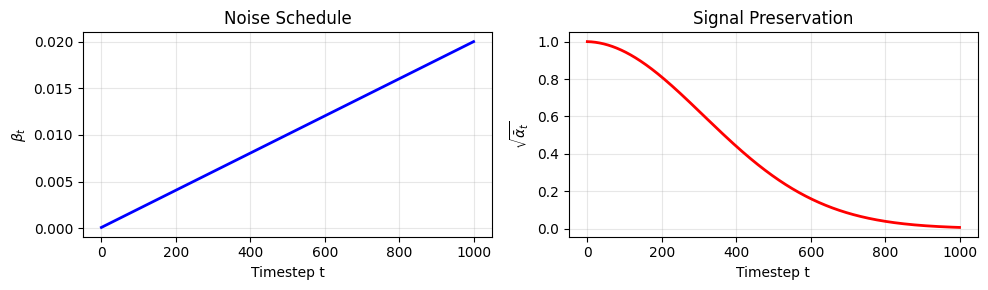

In [39]:

# Noise schedule visualisation

# Extract diffusion parameters
betas = diffusion.betas.cpu().numpy()
alphas_bar = diffusion.alpha_bars.cpu().numpy()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 3))

# Beta schedule
ax1.plot(np.arange(len(betas)), betas, color='blue', linewidth=2)
ax1.set(xlabel='Timestep t', ylabel='$\\beta_t$', title='Noise Schedule')
ax1.grid(True, alpha=0.3)

# Alpha bar (cumulative)
ax2.plot(np.arange(len(alphas_bar)), np.sqrt(alphas_bar), color='red', linewidth=2)
ax2.set(xlabel='Timestep t', ylabel='$\\sqrt{\\bar{\\alpha}_t}$', title='Signal Preservation')
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

1. Beta Schedule (Left Plot - Blue)

- Linear progression from beta_start=0.0001 to beta_end=0.02
- Very gradual start: β₀ = 0.0001 means almost no noise added in early steps
- Linear increase ensures smooth transition

2. Alpha Bar Schedule (Right Plot - Red)

- Represents the signal preservation coefficient at each step
- Starts near 1.0: Almost all original signal preserved initially
- Gradual decay: Smooth transition to near-zero signal preservation


- Early steps (t=0-200): minimal noise
- Middle steps (t=400-600): moderate noise)  
- Late steps (t=800-1000): significant noise)

Diffusing: 100%|██████████| 500/500 [00:00<00:00, 25684.97it/s]


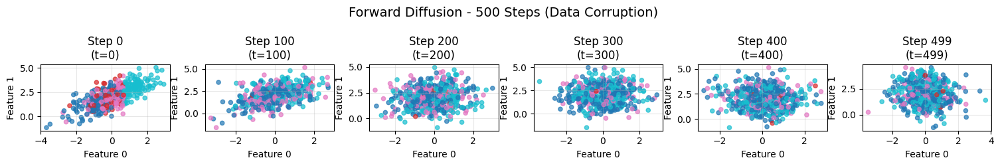

In [54]:
# Forward process - Data Corruption (500 steps)

@torch.no_grad()
def diffuse_all_steps(x0, num_steps=500):  # Changed to 500 steps
    """Diffuse data through multiple timesteps"""
    x_diffused = []
    steps = torch.linspace(0, diffusion.timesteps-1, num_steps, dtype=torch.long)
    
    for t in tqdm(steps, desc="Diffusing"):  # Added progress bar
        noisy_x, _ = diffusion.add_noise(x0, t)
        x_diffused.append(noisy_x.cpu())
    
    return x_diffused

# Get test samples
test_indices = np.random.choice(len(dataset), min(500, len(dataset)), replace=False)
x_test_continuous = torch.FloatTensor(dataset.continuous_data[test_indices]).to(device)
x_test_categorical = [torch.LongTensor(cat_data[test_indices]).to(device) 
                     for cat_data in dataset.categorical_data]

# Embed test data
x_test_embedded = embedding_module(x_test_continuous, x_test_categorical)

# Diffuse through time with 500 steps
x_noisy_steps = diffuse_all_steps(x_test_embedded, num_steps=500)

# Plot key steps from the 500-step process
plot_steps = [0, 100, 200, 300, 400, 499]  # Key milestones in 500 steps
colors = plt.cm.cividis(np.linspace(0.2, 0.8, len(plot_steps)))

fig, axes = plt.subplots(nrows=1, ncols=len(plot_steps), figsize=(15, 2.5))

for idx, (step, color) in enumerate(zip(plot_steps, colors)):
    # Convert back to original space
    cont_data, cat_data = embedded_to_original(x_noisy_steps[step])
    cont_data_denorm = dataset.scaler.inverse_transform(cont_data)
    
    # Plot
    ax = axes[idx]
    ax.scatter(cont_data_denorm[:, 0], cont_data_denorm[:, 1], 
               c=cat_data[0], s=20, alpha=0.7, cmap='tab10')
    ax.set_title(f'Step {step}\n(t={step})')
    ax.set_xlabel('Feature 0')
    ax.set_ylabel('Feature 1')
    ax.grid(True, alpha=0.3)

plt.suptitle('Forward Diffusion - 500 Steps (Data Corruption)', fontsize=14)
plt.tight_layout()
plt.show()

Denoising: 100%|██████████| 500/500 [00:00<00:00, 2996.19it/s]


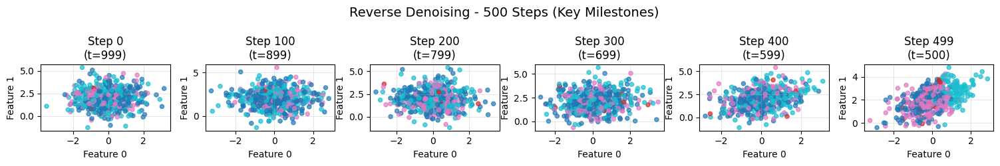

In [53]:
# Reverse process - Denoising (500 steps)

@torch.no_grad()
def denoise_all_steps(x_T, num_steps=500):  # Changed to 500 steps
    """Denoise through multiple reverse steps"""
    x_denoised = [x_T.cpu()]
    current_x = x_T.clone()
    
    reverse_steps = torch.linspace(diffusion.timesteps-1, 0, num_steps, dtype=torch.long)
    
    for t in tqdm(reverse_steps, desc="Denoising"):  # Added progress bar
        t_batch = torch.full((x_T.shape[0],), t, device=device, dtype=torch.long)
        
        # Predict noise
        predicted_noise = model(current_x, t_batch)
        
        # Get parameters
        alpha = diffusion.alphas[t].reshape(-1, 1)
        alpha_bar = diffusion.alpha_bars[t].reshape(-1, 1)
        beta = diffusion.betas[t].reshape(-1, 1)
        
        if t > 0:
            noise = torch.randn_like(current_x)
        else:
            noise = torch.zeros_like(current_x)
        
        # Reverse step
        current_x = (1 / torch.sqrt(alpha)) * (
            current_x - ((1 - alpha) / (torch.sqrt(1 - alpha_bar))) * predicted_noise
        ) + torch.sqrt(beta) * noise
        
        x_denoised.append(current_x.cpu())
    
    return x_denoised

# Start from pure noise
x_noise = torch.randn(500, model.input_dim).to(device)

# Generate through reverse process with 500 steps
x_denoise_steps = denoise_all_steps(x_noise, num_steps=500)

# Plot key steps from the 500-step process
plot_steps = [0, 100, 200, 300, 400, 499]  # Key milestones in 500 steps
reverse_colors = plt.cm.magma(np.linspace(0.8, 0.2, len(plot_steps)))

fig, axes = plt.subplots(nrows=1, ncols=len(plot_steps), figsize=(15, 2.5))

for idx, (step, color) in enumerate(zip(plot_steps, reverse_colors)):
    # Convert back to original space
    cont_data, cat_data = embedded_to_original(x_denoise_steps[step])
    cont_data_denorm = dataset.scaler.inverse_transform(cont_data)
    
    # Plot
    ax = axes[idx]
    ax.scatter(cont_data_denorm[:, 0], cont_data_denorm[:, 1], 
               c=cat_data[0], s=20, alpha=0.7, cmap='tab10')
    ax.set_title(f'Step {step}\n(t={diffusion.timesteps-1 - step})')
    ax.set_xlabel('Feature 0')
    ax.set_ylabel('Feature 1')
    ax.grid(True, alpha=0.3)

plt.suptitle('Reverse Denoising - 500 Steps', fontsize=14)
plt.tight_layout()
plt.show()

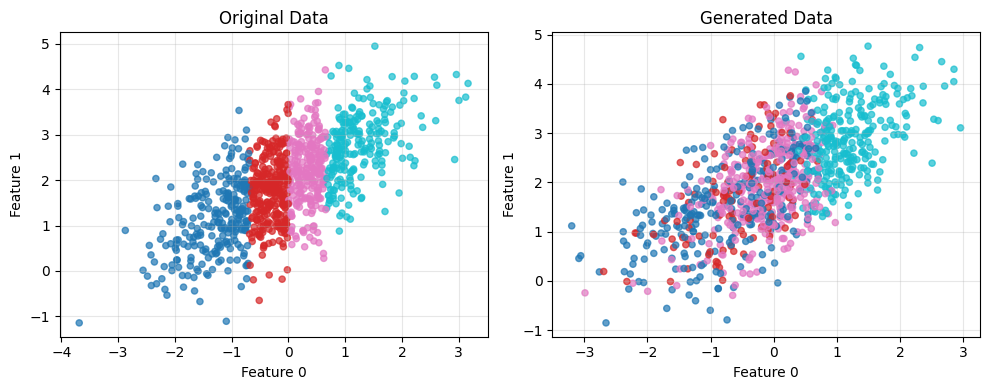

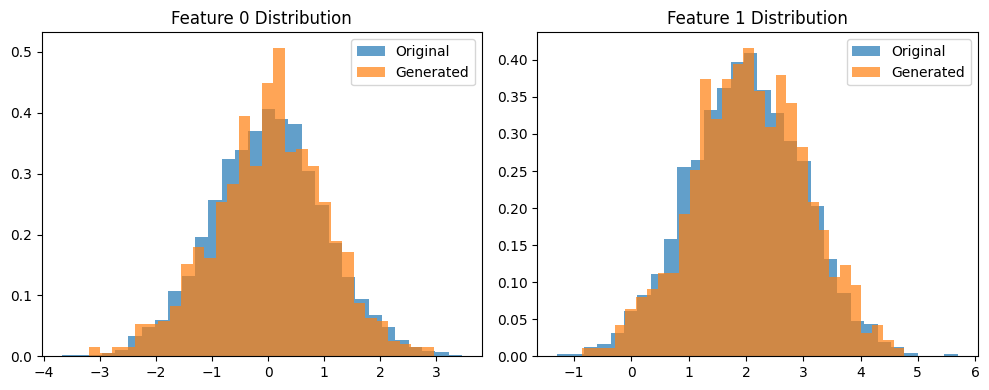

In [52]:
# Generate final samples properly
generated_continuous, generated_categorical = diffusion.sample(
    model, embedding_module, 1000, 
    (1000, dataset.continuous_data.shape[1]),
    [(1000, n_cat) for n_cat in dataset.num_categories]
)

# Denormalize for proper visualization
generated_continuous_denorm = dataset.scaler.inverse_transform(generated_continuous)
original_continuous_denorm = dataset.scaler.inverse_transform(dataset.continuous_data)

# Plot comparison
fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Original data
axes[0].scatter(original_continuous_denorm[:1000, 0], original_continuous_denorm[:1000, 1], 
                c=dataset.categorical_data[0][:1000], s=20, alpha=0.7, cmap='tab10')
axes[0].set_title('Original Data')
axes[0].set_xlabel('Feature 0')
axes[0].set_ylabel('Feature 1')
axes[0].grid(True, alpha=0.3)

# Generated data
scatter = axes[1].scatter(generated_continuous_denorm[:, 0], generated_continuous_denorm[:, 1], 
                         c=generated_categorical[0], s=20, alpha=0.7, cmap='tab10')
axes[1].set_title('Generated Data')
axes[1].set_xlabel('Feature 0')
axes[1].set_ylabel('Feature 1')
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Also show distribution comparison
fig, axes = plt.subplots(1, 2, figsize=(10, 4))

# Feature 0 distribution
axes[0].hist(original_continuous_denorm[:, 0], alpha=0.7, label='Original', bins=30, density=True)
axes[0].hist(generated_continuous_denorm[:, 0], alpha=0.7, label='Generated', bins=30, density=True)
axes[0].set_title('Feature 0 Distribution')
axes[0].legend()

# Feature 1 distribution  
axes[1].hist(original_continuous_denorm[:, 1], alpha=0.7, label='Original', bins=30, density=True)
axes[1].hist(generated_continuous_denorm[:, 1], alpha=0.7, label='Generated', bins=30, density=True)
axes[1].set_title('Feature 1 Distribution')
axes[1].legend()

plt.tight_layout()
plt.show()